In [2]:
import keras
from keras import layers
from keras import models
from keras import optimizers
from keras import losses
from keras.preprocessing.image import ImageDataGenerator
import os
import numpy as np
import pickle
from matplotlib import pyplot as plt

Using TensorFlow backend.


In [3]:
def smooth_curve(data):
    smoothed_data = []
    for i in range(len(data)):
        if i == 0:
            smoothed_data.append((data[i]*2 + data[i+1])/3)
        elif i == len(data)-1:
            smoothed_data.append((data[i]*2 + data[i-1])/3)
        else:
            smoothed_data.append((data[i-1] + data[i] + data[i+1])/3)
    return smoothed_data

In [4]:
def plot_res(hists):
    colors = ['b', 'r', 'g', 'c', 'y', 'k', 'm']

    plt.figure(figsize=(20, 15))
    i = 0
    for hist_name in hists.keys():
        hist = hists[hist_name]
        history = hist.get("history")
        epoches = len(history['acc'])
        plt.plot(range(epoches), smooth_curve(history['acc']), '%so'%colors[i], label="%s_acc"%hist_name)
        plt.plot(range(epoches), smooth_curve(history['val_acc']), "%s"%colors[i], label='%s_val_acc'%hist_name)
        i += 1
    plt.legend()
    plt.xlabel("epoch")
    plt.ylabel("acc")
    plt.title("acc")

    plt.figure(figsize=(20, 15))
    i = 0
    for hist_name in hists.keys():
        hist = hists[hist_name]
        history = hist.get("history")
        epoches = len(history['loss'])
        plt.plot(range(epoches), smooth_curve(history['loss']), '%so'%colors[i], label="%s_acc"%hist_name)
        plt.plot(range(epoches), smooth_curve(history['val_loss']), "%s"%colors[i], label='%s_val_loss'%hist_name)
        i += 1
    plt.legend()
    plt.xlabel("epoch")
    plt.ylabel("loss")
    plt.title("loss")

    plt.show()

In [35]:
def plot_res_cpmpare_model(hists,models):
    colors = ['b', 'r', 'g', 'c', 'y', 'k', 'm']
    markers = ['.', ',', 'o', 'v', '1', '2', '3', '4',]

    plt.figure(figsize=(20, 15))
    for j,model in enumerate(models):
        cur_model_hists = [h for h in hists if h["model"].startswith(model)]
        for i,h in enumerate(cur_model_hists):
            name = h["features"]
            history = h.get("hist")
            epoches = len(history['val_acc'])
#             plt.plot(range(epoches), smooth_curve(history['acc']), '%so'%markers[i], label="%s_acc"%hist_name)
            plt.plot(range(epoches), smooth_curve(history['val_acc']), "%s%s"%(markers[i],colors[j]), label='%s_val_acc'%name)
    plt.legend()
    plt.xlabel("epoch")
    plt.ylabel("acc")
    plt.title("acc")

    plt.figure(figsize=(20, 15))
    for j,model in enumerate(models):
        cur_model_hists = [h for h in hists if h["model"].startswith(model)]
        for i,h in enumerate(cur_model_hists):
            name = h["features"]
            history = h.get("hist")
            epoches = len(history['val_loss'])
#             plt.plot(range(epoches), smooth_curve(history['acc']), '%so'%markers[i], label="%s_acc"%hist_name)
            plt.plot(range(epoches), smooth_curve(history['val_loss']), "%s%s"%(markers[i],colors[j]), label='%s_val_loss'%name)
    plt.legend()
    plt.xlabel("epoch")
    plt.ylabel("loss")
    plt.title("loss")

    plt.show()

In [5]:
def get_model1(nb_class):
    #三层卷积网络,在activation后加入batchnorminization
    model = models.Sequential()
    model.add(layers.Conv2D(32, (3, 3),input_shape=(150, 150, 3)))
    model.add(layers.Activation(activation="relu"))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(64, (3, 3)))
    model.add(layers.Activation(activation="relu"))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3)))
    model.add(layers.Activation(activation="relu"))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3)))
    model.add(layers.Activation(activation="relu"))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dense(512, activation='relu'))
    model.add(layers.Dense(nb_class, activation='softmax'))
    return model

In [6]:
def get_model2(nb_class):
    #三层卷积网络,在activation后加入batchnorminization
    model = models.Sequential()
    model.add(layers.Conv2D(32, (3, 3), activation='relu',input_shape=(150, 150, 3)))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.BatchNormalization())
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dense(512, activation='relu'))
    model.add(layers.Dense(nb_class, activation='softmax'))
    return model

In [7]:
def get_model3(nb_class):
    #三层卷积网络，带dropout,无batchnormalization
    model = models.Sequential()
    model.add(layers.Conv2D(32, (3, 3), activation='relu',input_shape=(150, 150, 3)))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.5))
    model.add(layers.Dense(512, activation='relu'))
    model.add(layers.Dense(23, activation='softmax'))
    return model

In [4]:
def get_dense_model(nb_class,input_dim):
    #单层全连接网络，用于训练预提取的features
    model = models.Sequential()
    model.add(layers.Dense(256, activation='relu', input_dim=input_dim))
    model.add(layers.Dropout(0.5))
    model.add(layers.Dense(nb_class, activation='softmax'))
    return model

In [9]:
def get_model5(conv_base,nb_class):
    #联合训练，只训练最后的自定义层
    conv_base.trainable = False
    model = models.Sequential()
    model.add(conv_base)
    model.add(layers.Flatten())
    model.add(layers.Dense(256, activation='relu'))
    model.add(layers.Dense(nb_class, activation='softmax'))
    return model

In [10]:
def fine_tune(conv_base,layer_name):
    #联合训练，包含部分预训练模型的层
    conv_base.trainable = True
    set_trainable = False
    for layer in conv_base.layers:
        if layer.name == layer_name:
            set_trainable = True
        if set_trainable:
            layer.trainable = True
        else:
            layer.trainable = False      

In [11]:
def get_data_generator(base_dir):
    #获取generator
    #base_dir = r'G:\pic_data\dpm\dataset\dir_dataset\dpm_split_23'
    train_dir = os.path.join(base_dir,'train')
    validation_dir = os.path.join(base_dir,'validation')
    test_dir = os.path.join(base_dir,'test')

    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,)
    test_datagen = ImageDataGenerator(rescale=1./255)
    
    train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(150, 150),
        batch_size=32,
        class_mode='categorical')
    validation_generator = test_datagen.flow_from_directory(
        validation_dir,
        target_size=(150, 150),
        batch_size=32,
        class_mode='categorical')
    
    return train_generator,validation_generator

In [2]:
def extract_features(model,directory,batch_size):
    #利用预训练网络提取特征
    import os
    sample_count = sum(len(os.listdir(os.path.join(directory,subdir))) for subdir in os.listdir(directory))
    
    feature_shape = model.output.shape[1:]
    print(feature_shape)
    input_shape = model.input_shape[1:3]
    print(model.input_shape)
    features = np.zeros((sample_count,feature_shape[0],feature_shape[1],feature_shape[2]))
    labels = np.zeros(shape=(sample_count,len(os.listdir(directory))))
    datagen = ImageDataGenerator(rescale=1./255)
    generator = datagen.flow_from_directory(
        directory,
        target_size=input_shape,
        batch_size=batch_size,
        class_mode='categorical')
    i = 0
    

    for input_batch,labels_batch in generator:
        features_batch = model.predict(input_batch)
        features[i*batch_size:(i+1)*batch_size] = features_batch
        labels[i*batch_size:(i+1)*batch_size] = labels_batch
        i += 1
        print("第%s个"%(i*batch_size))
        if i * batch_size >= sample_count:
            break
    return features,labels        

In [14]:
train_generator,validation_generator = get_data_generator(r'G:\pic_data\dpm\dataset\dir_dataset\dpm_split_23')

Found 4256 images belonging to 23 classes.
Found 1419 images belonging to 23 classes.


In [59]:
base_dir = r'G:\pic_data\dpm\dataset\dir_dataset\dpm_split_23'
train_dir = os.path.join(base_dir,'train')
validation_dir = os.path.join(base_dir,'validation')
test_dir = os.path.join(base_dir,'test')

x,y = extract_features(
    keras.applications.InceptionV3(weights="imagenet",include_top=False,input_shape=(224,224,3)),
    r"G:\pic_data\dpm\origin\type10",4)

with open(r"features\inceptionv3_dpm_10_224",'wb') as f:
    pickle.dump({"x":x,"y":y},f)
    
print(r"features\inceptionv3_dpm_10_224","完成")

In [62]:
import os
import pickle
import numpy as np

In [67]:
with open(os.path.join(r"F:\jupyter-notebook\deeplearning\features","vgg16_dpm_10_224_batch1"),'rb') as f:
    data = pickle.load(f)

In [68]:
x = data["x"]
y = data["y"]

In [69]:
x = np.reshape(x,(x.shape[0],-1))

In [70]:
x.shape

(5147, 25088)

In [21]:
slices = np.arange(len(x))

In [22]:
np.random.shuffle(slices)

In [23]:
X = x[slices]
y = y[slices]
print(X.shape,y.shape)

(5147, 18432) (5147, 10)


In [30]:
model2 = get_dense_model(10,18432)

In [31]:
model2.compile(optimizer=optimizers.RMSprop(lr=1e-4),loss=losses.categorical_crossentropy,metrics=['acc'])

In [32]:
tb = keras.callbacks.TensorBoard(log_dir="test2",histogram_freq=1,write_graph=1)
hist2 = model2.fit(X[:3000],y[:3000],epochs=30,batch_size=32,shuffle=True,validation_split=0.33,verbose=2)

Train on 2009 samples, validate on 991 samples
Epoch 1/30
 - 5s - loss: 2.0419 - acc: 0.5674 - val_loss: 0.8755 - val_acc: 0.7245
Epoch 2/30
 - 4s - loss: 0.9702 - acc: 0.7143 - val_loss: 0.7049 - val_acc: 0.7770
Epoch 3/30
 - 4s - loss: 0.6817 - acc: 0.7850 - val_loss: 0.7161 - val_acc: 0.7931
Epoch 4/30
 - 4s - loss: 0.5637 - acc: 0.8248 - val_loss: 0.6792 - val_acc: 0.7921
Epoch 5/30
 - 4s - loss: 0.4303 - acc: 0.8571 - val_loss: 0.7521 - val_acc: 0.7982
Epoch 6/30
 - 4s - loss: 0.3975 - acc: 0.8776 - val_loss: 0.6961 - val_acc: 0.8042
Epoch 7/30
 - 4s - loss: 0.2972 - acc: 0.9064 - val_loss: 0.9821 - val_acc: 0.8012
Epoch 8/30
 - 4s - loss: 0.2210 - acc: 0.9253 - val_loss: 1.0472 - val_acc: 0.7941
Epoch 9/30
 - 4s - loss: 0.2266 - acc: 0.9288 - val_loss: 0.7548 - val_acc: 0.8234
Epoch 10/30
 - 4s - loss: 0.1920 - acc: 0.9368 - val_loss: 0.8273 - val_acc: 0.8103
Epoch 11/30
 - 4s - loss: 0.1414 - acc: 0.9522 - val_loss: 0.8240 - val_acc: 0.8184
Epoch 12/30
 - 4s - loss: 0.1606 - acc

In [35]:
model2.save(r"models\model2.h5")

In [38]:
from PIL import Image
from keras.preprocessing import image

In [81]:
model1 = keras.applications.InceptionV3(weights="imagenet",include_top=False,input_shape=(150,150,3))

In [171]:
def plot_err_img(base_dir,class_idx,model1,model2,img_save_dir):
#     base_dir = r"G:\pic_data\dpm\origin\type10"
    
    classes = os.listdir(r"G:\pic_data\dpm\origin\type10")
    print("开始计算:{}".format(classes[class_idx]))
    class_dir = os.path.join(base_dir,classes[class_idx])
    f_imgs = os.listdir(class_dir)
    nb = len(f_imgs)
    np.random.shuffle(f_imgs)
    x = np.zeros((nb,150,150,3))
    for i,f_img in enumerate(f_imgs[:nb]):
        img = image.load_img(os.path.join(class_dir,f_img),target_size=(150,150))
        img_arr = image.img_to_array(img)
        x[i] = img_arr

    x = x/255

    features = model1.predict(x)
    features = np.reshape(features,(features.shape[0],-1))
    predicts = model2.predict(features)
    predicts = np.argmax(predicts,axis=1)

    print(predicts)

    wrong_idxs = [(x,y) for x,y in enumerate(predicts) if y != class_idx]
    err = len(wrong_idxs) / nb
    wrong_idxs.sort(key=lambda x: x[1])
    wrong_imgs = [f_imgs[x[0]] for x in wrong_idxs]

    c = 6
    r = 4
    for i,j in enumerate(wrong_idxs):
        if(i%(r*c)==0):
            plt.figure(figsize=(20,15))
            plt.suptitle("class:{}   num:{}   err:{:.3f}".format(classes[class_idx],nb,err))
        plt.subplot(r,c,i%(r*c)+1)
        plt.axis("off")
        plt.imshow(image.array_to_img(x[j[0]]))
        plt.title(classes[j[1]])
        if (i+1)%(r*c)==0:
    #         plt.show()
            plt.savefig(r"{}\{}_{}.png".format(img_save_dir,classes[class_idx],(i+1)//(r*c)))
    if len(wrong_idxs)%(r*c) != 0:
        plt.savefig(r"{}\{}_{}.png".format(img_save_dir,classes[class_idx],(len(wrong_idxs)//(r*c))+1))
    plt.show()
    
    return err

In [172]:
base_dir = r"G:\pic_data\dpm\origin\type10"

开始计算:bamboos
[8 0 0 0 0 0 0 0 1 6 4 0 0 0 7 0 0 0 0 0 0 0 0 8 2 0 7 0 0 0 0 0 6 0 7 2 0
 0 0 2 0 0 1 0 2 1 0 4 8 0 0 1 1 0 0 0 6 0 0 0 0 0 0 0 0 0 0 0 7 2 0 8 8 0
 3 6 6 0 0 1 0 4 0 0 0 2 0 0 0 0 0 0 0 4 0 0 0 0 0 0 7 0 1 0 0 0 0 0 0 0 0
 0 0 0 0 6 0 0 8 0 0 0 0 0 0 0 6 0 6 0 0 8 0 0 2 0 0 0 2 0 1 0 0 0 2 0 0 0
 0 0 8 2 7 0 0 0 0 2 0 1 0 0 0 0 0 1 0 0 1 0 2 0 0 0 0 0 0 0 0 0 0 0 2 2 0
 0 0 0 2 3 0 1 0 6 0 6 0 6 1 0 0 3 0 0 2 0 0 0 0 7 0 1 0 0 0 0 6 7 7 2 0 0
 1 0 0 0 0 0 0 2 0 0 0 0 6 2 0 2 0 0 0 0 0 2 0 1 2 0 2 2 0 0 0 0 7 0 0 2 6
 0 0 0 0 0 0 0 0 0 4 0 2 6 0 0 4 0 0 2 0 0 2 6 0 0 2 0 2 0 0 0 0 0 0 0 2 0
 0 0 0 7 0 7]


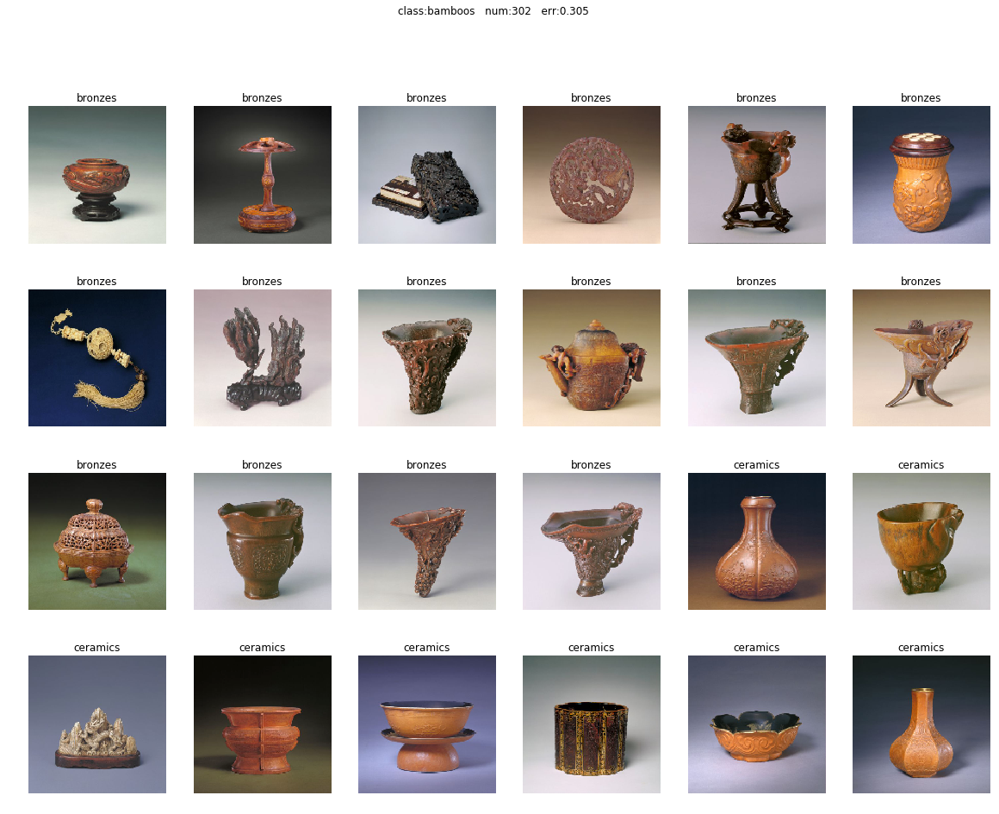

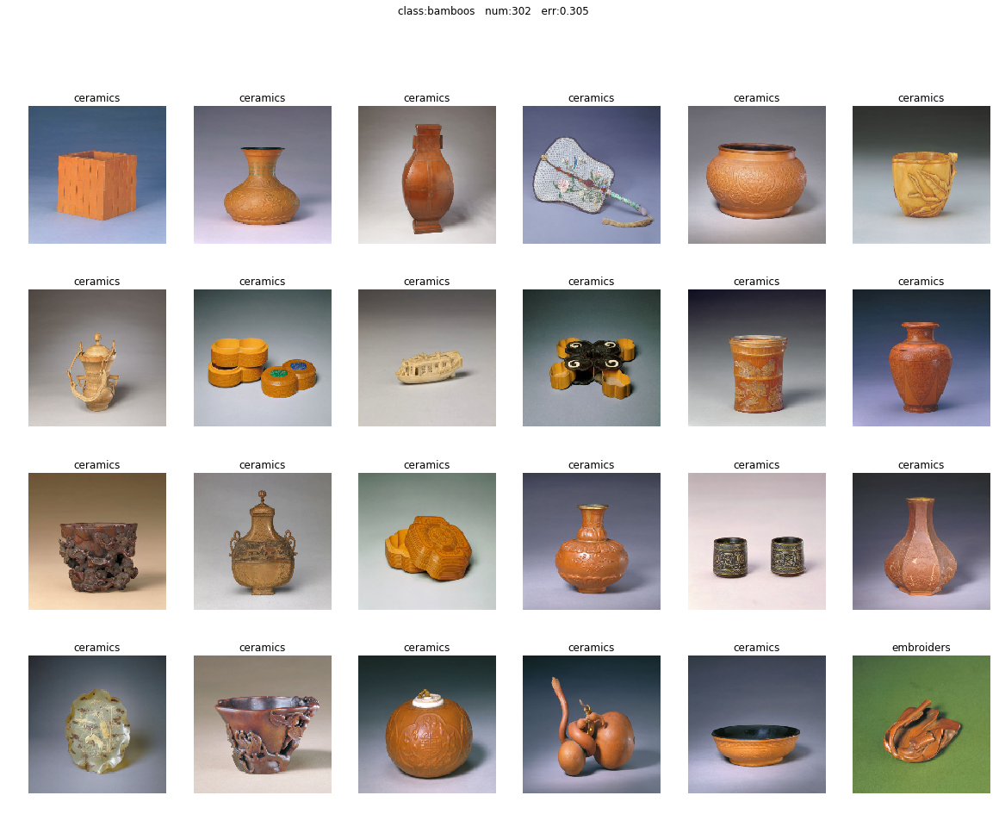

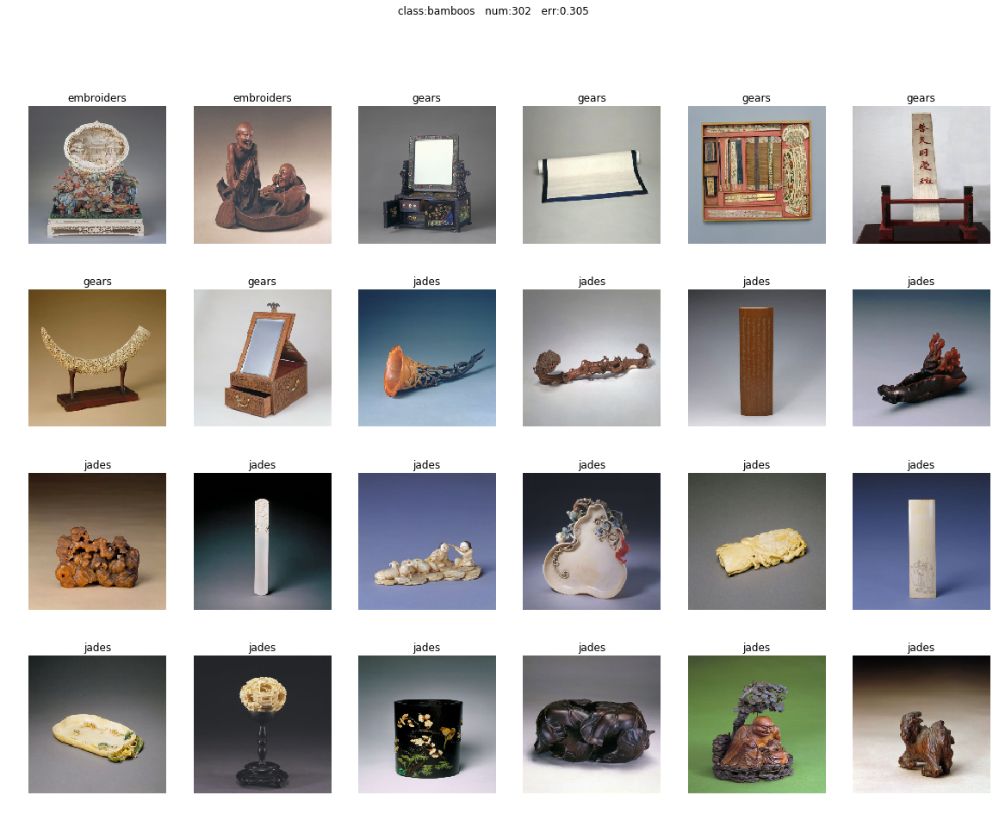

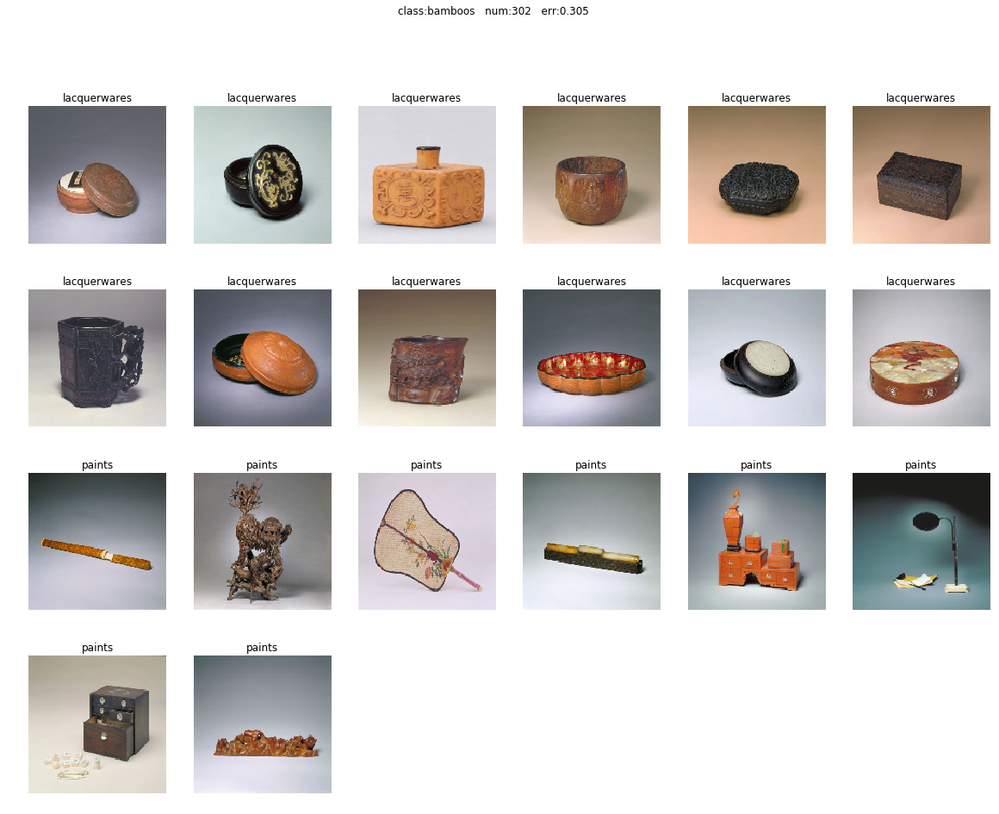

开始计算:bronzes
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 2 1 1 1 6 2 1 1 2
 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 2 2 1 1 2 2 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 2 1 6 1 1 3 1 2 1 1
 1 1 1 1 1 2 2 1 1 1 9 1 1 1 2 1 1 1 1 2 1 1 1 6 1 1 1 1 1 1 6 1 1 1 1 2 1
 1 1 1 1 6 6 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 6 2 1 1 1 1 1 7 1 1 1 1
 1 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 3 1 1 1 1 1 1 1 1 1 2 0
 1 1 1 1 2 1 1 1 1 1 2 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 9 2 1 1 1 0 1 1]


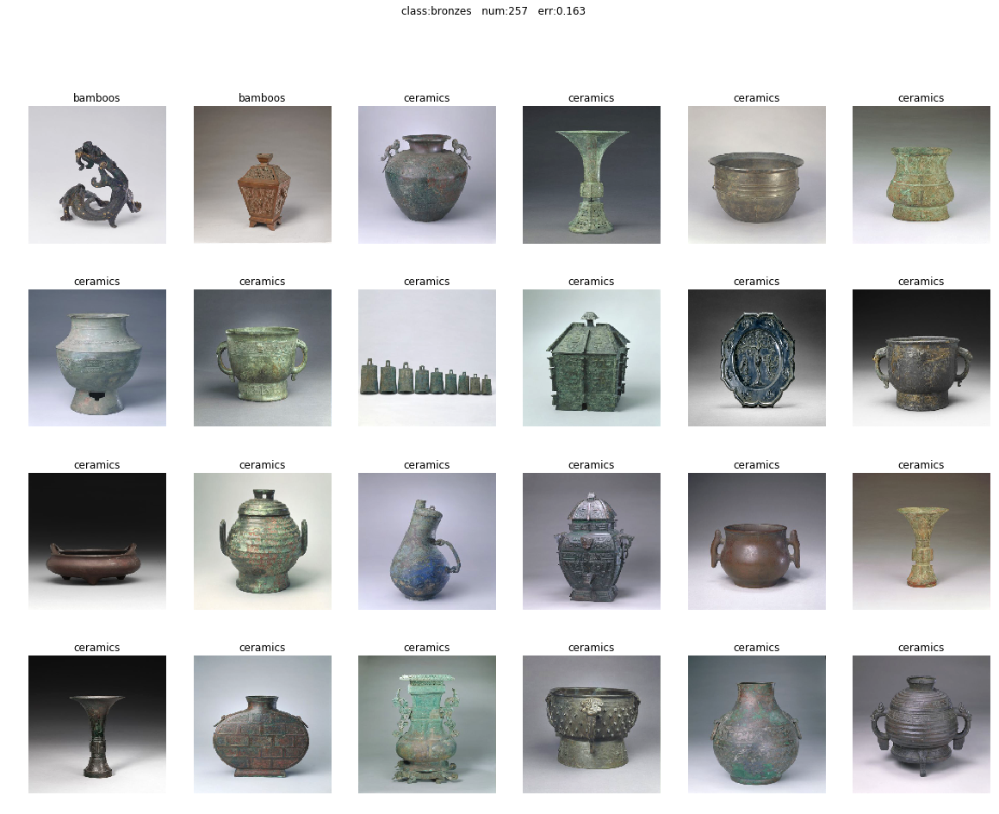

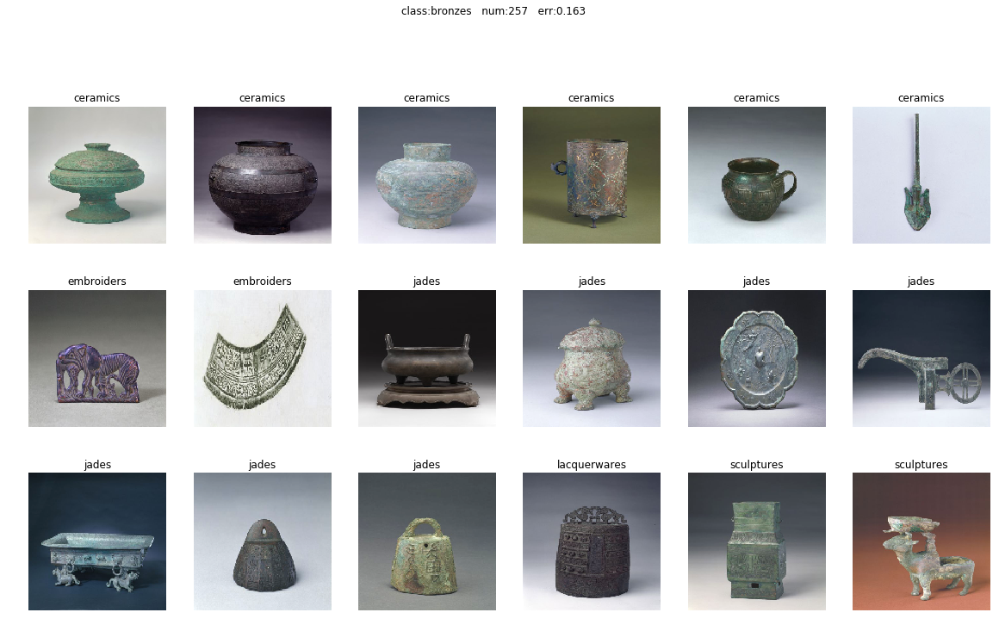

开始计算:ceramics
[2 2 2 ..., 2 6 2]


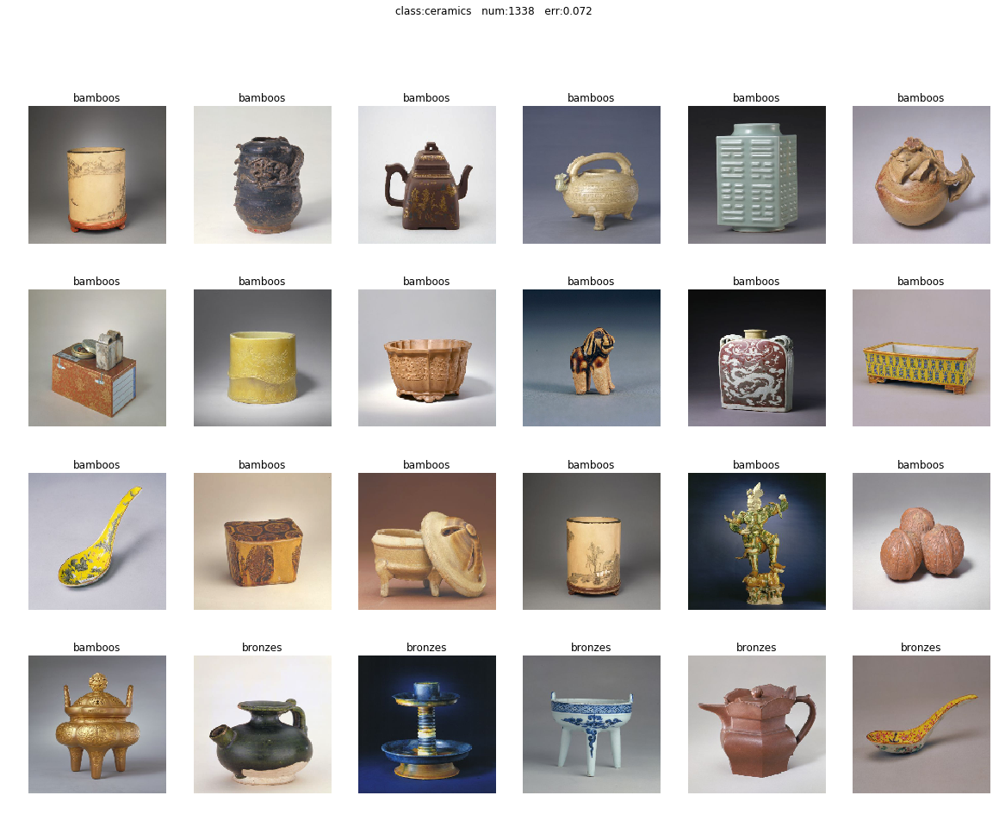

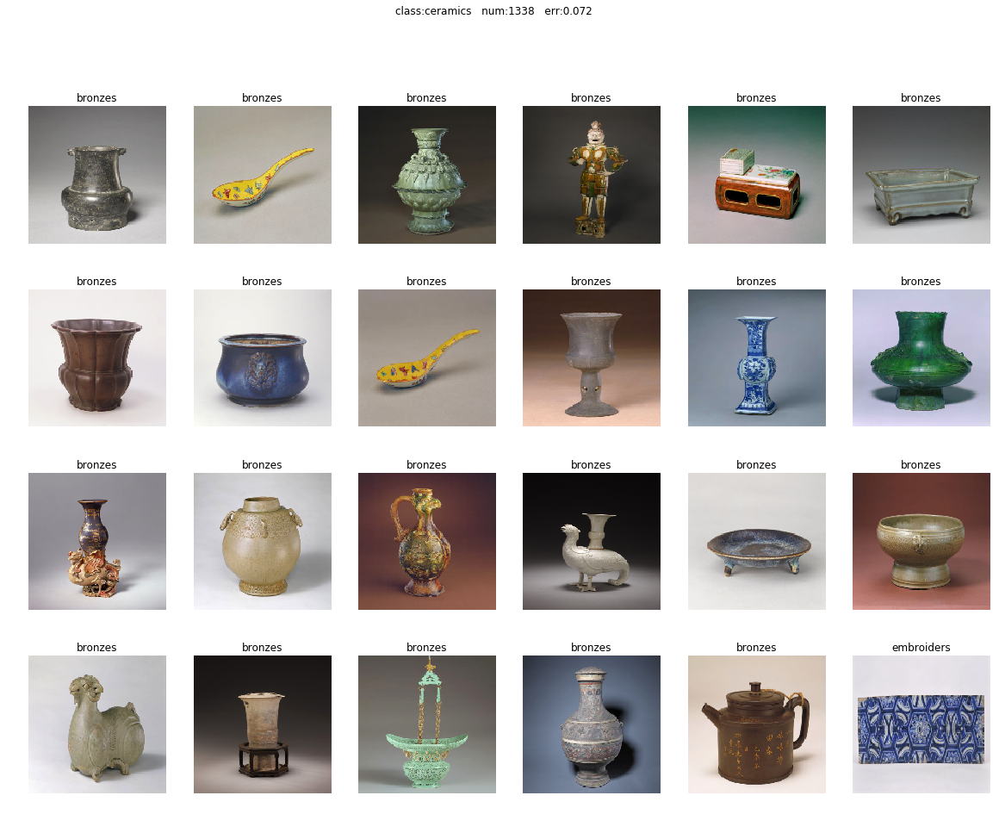

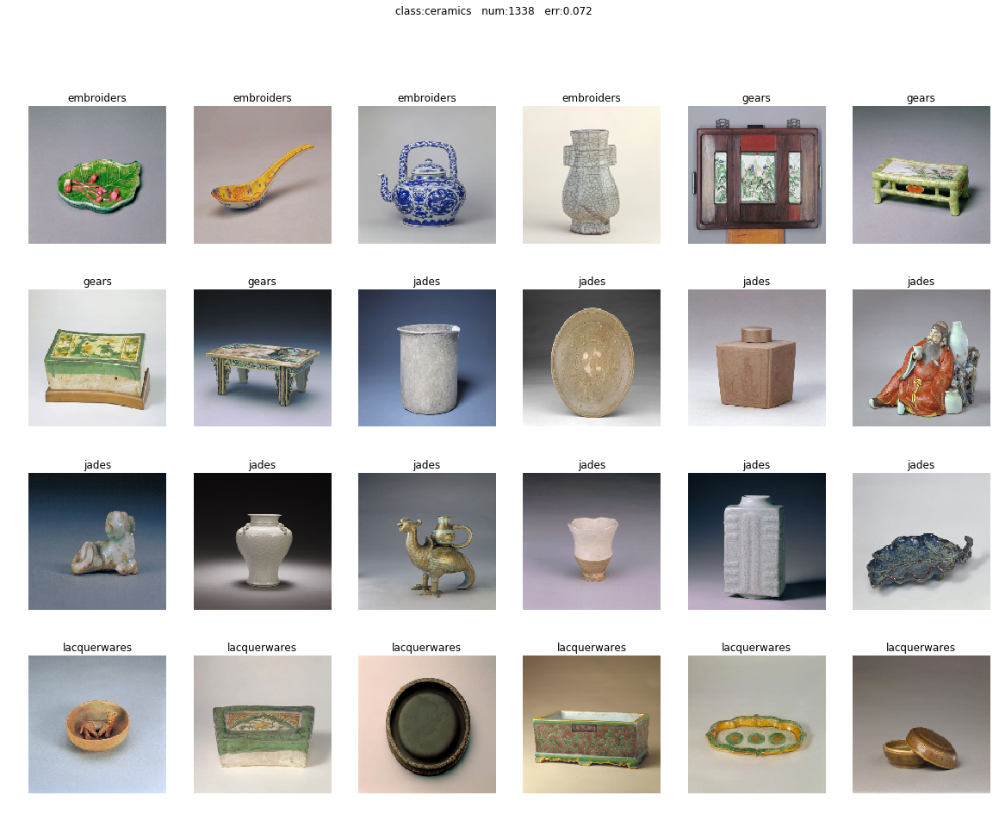

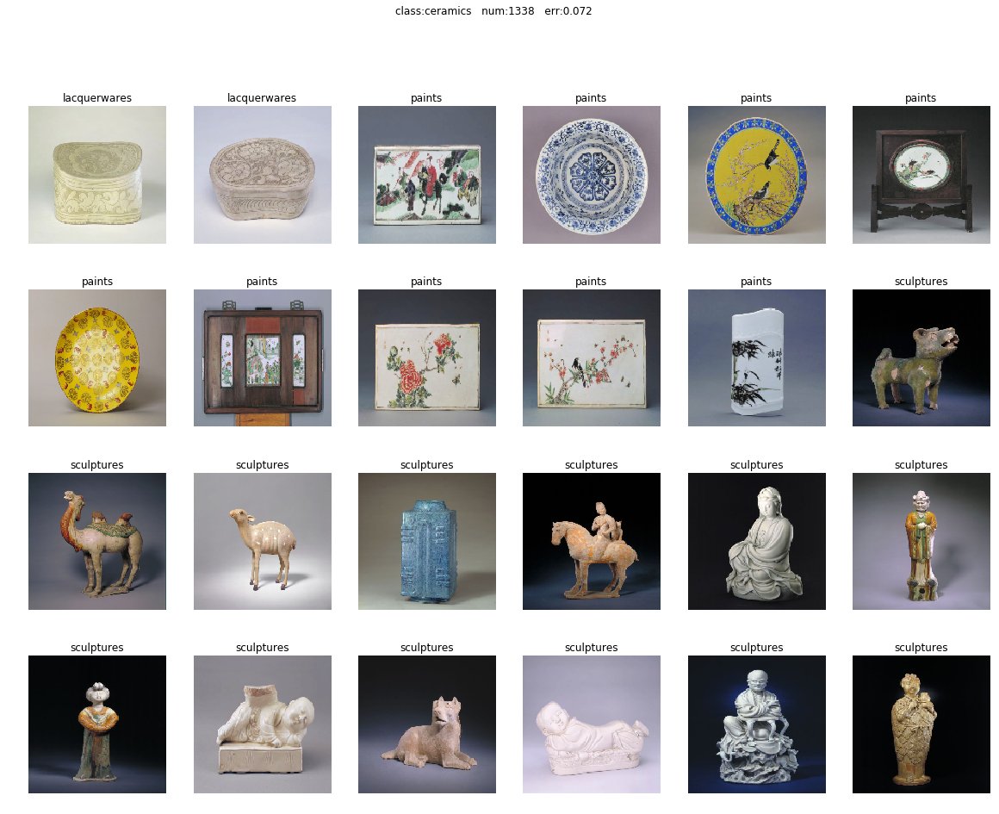

开始计算:embroiders
[3 3 8 3 3 3 3 3 3 8 3 3 8 3 3 3 3 3 8 3 3 8 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 8 3 3 3 3 3 3 1 3 3 3 3 8 3 3 3 3 3 3 5 3 3 3 3 3 3 3 3 8 3 3 3 4 3 8 5 3
 3 3 3 3 3 3 3 3 3 3 3 5 3 3 3 3 3 3 3 8 3 3 3 3 3 3 3 3 3 3 3 3 8 8 3 8 3
 3 3 3 3 3 5 3 3 3 8 3 3 3 3 3 8 7 3 3 3 0 8 3 8 3 3 3 3 8 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 8 3 3 3 3 3 3 3 3 8 3 3 3 8 8 3 3 4 3 3 3 3 3 3 3 3 3 8 3 3 3
 3 3 3 3 2 1 3 3 3 6 3 3 3 3 3 8 3 3 3 3 3 3 3 3 3 3 3 3 8 3 3 3 3 3 3 3 3
 5 3 3 3 3 8 3 3 3 8 3 3 3 3 3 8 3 3 3 3 3 2 8 3 2 3 3 3 3 3 3 3 3 3 8 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 8 3 3 3 3 3 3 3 3 3 8 3 5 8 3 3 3 3 3 3 8 8 3 3
 3 3 3 3 3 8 3 3 8 3 7 3 3 3 3 3 3 4 3 3 3 3 3 3 8 3 3 8 3 3 8 3 3 3 3 3 3
 3 3 3 8 3 3 8 3 3 3 3 3 3 3 3 5 3 3 3 3 3 2 3 3 3 3 3 3 3 3 3 5 3 3 3 3 8
 8 3 3 3 3 3 3 3 5 3 3 3 8 8 3 3 4 3 3 3 8 3 3 3 3 8 3 3 3 3 3 3 8 3 8 3 8
 3 3 3 3 3 3 3 3 3 3 3 3 5 5 3 3 3 3 3 3 8 3 3 3 8 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3]


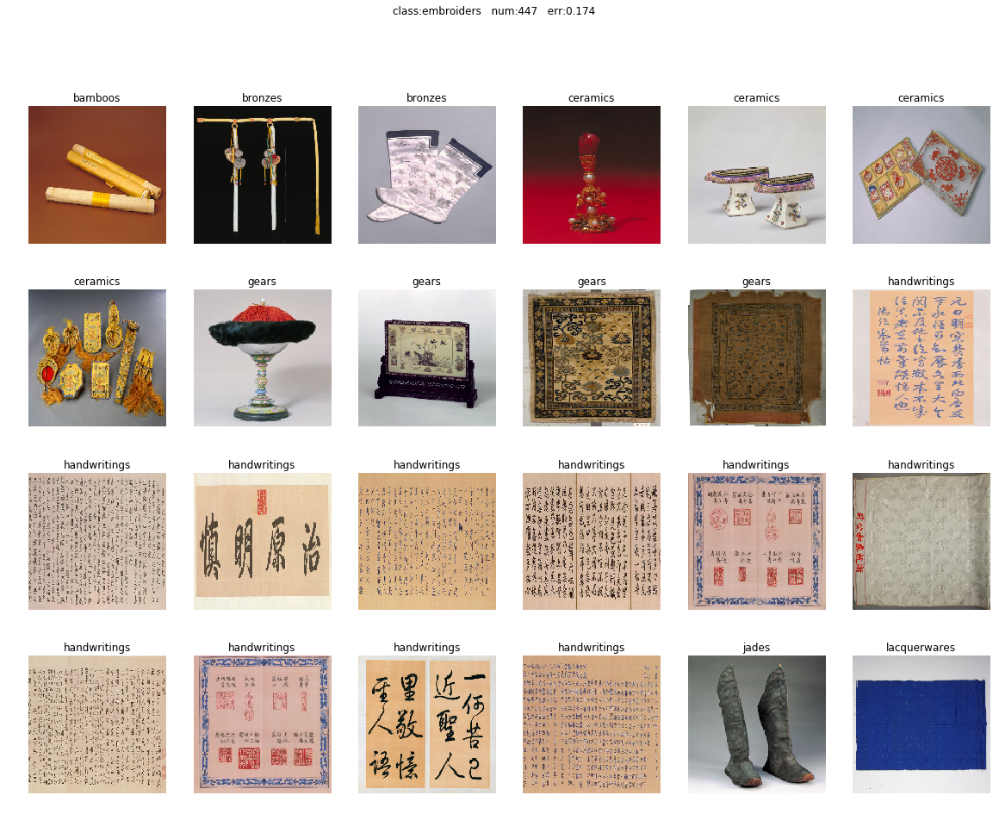

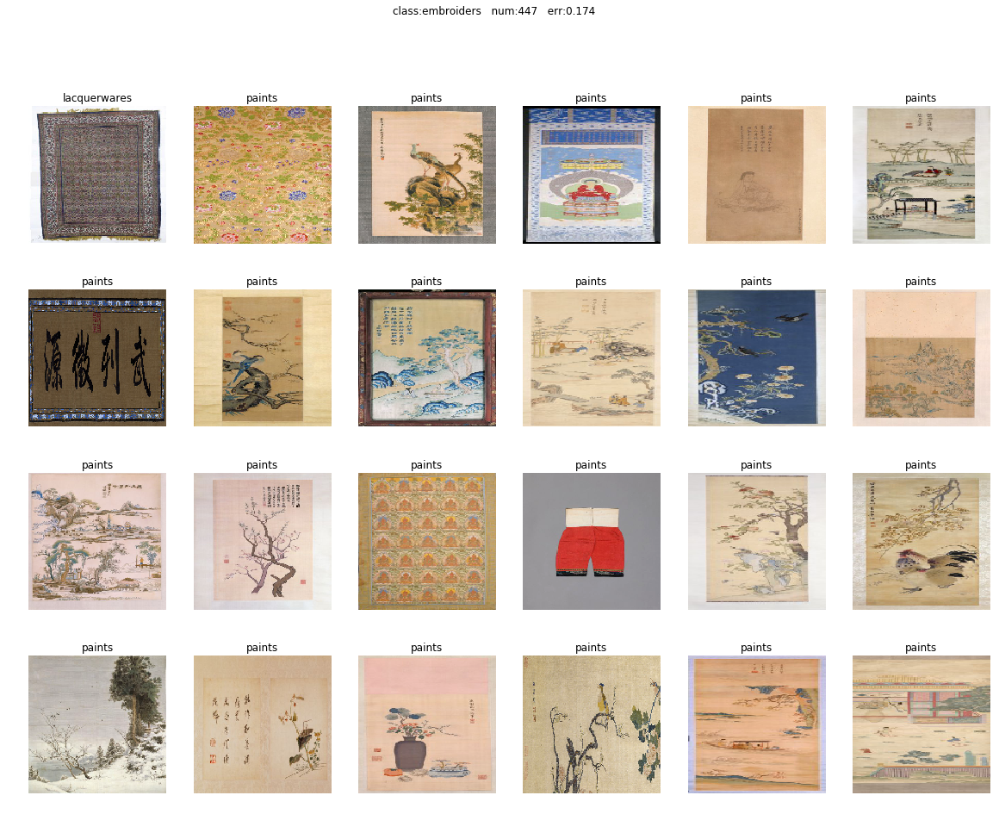

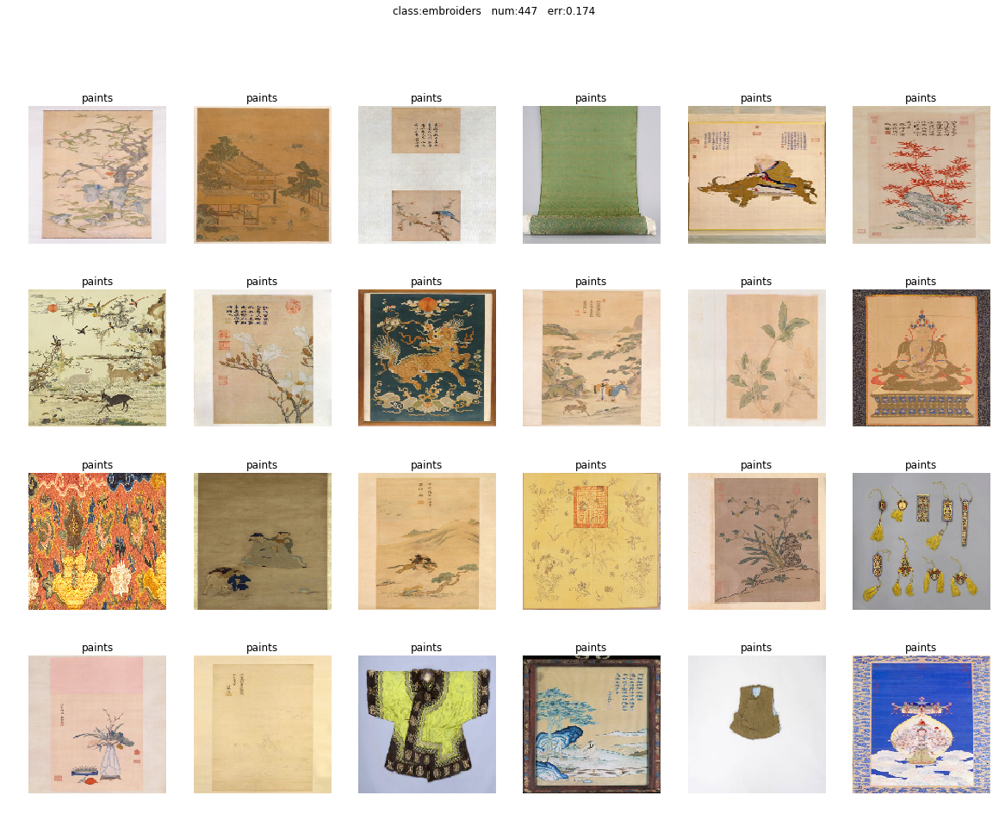

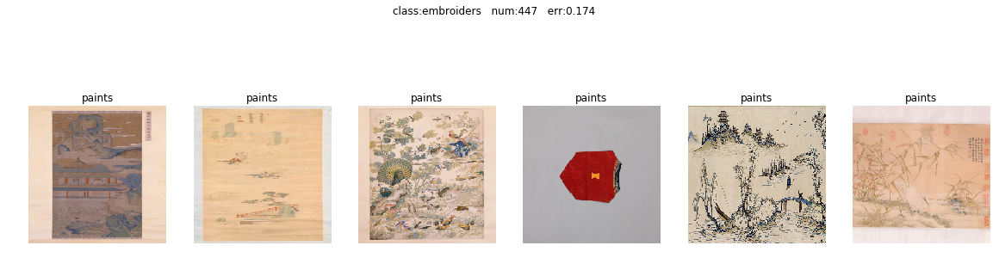

开始计算:gears
[4 8 2 4 4 4 4 4 4 4 4 4 4 4 4 4 4 1 4 4 6 4 4 1 4 4 4 4 4 1 4 4 4 4 4 4 4
 4 4 4 4 4 4 4 4 4 4 1 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 8 4 4 0
 4 4 4 4 4 4 4 1 4 4 4 7 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 0 4 4 4 4
 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 3 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 8 4 4 4 4 4 4 4 4 4 4 4 5 4 4 4 4 4 1 4 4 4 0 1 4 4 4 4 4 4 4 4 1
 8 4 1 4 4 4 4]


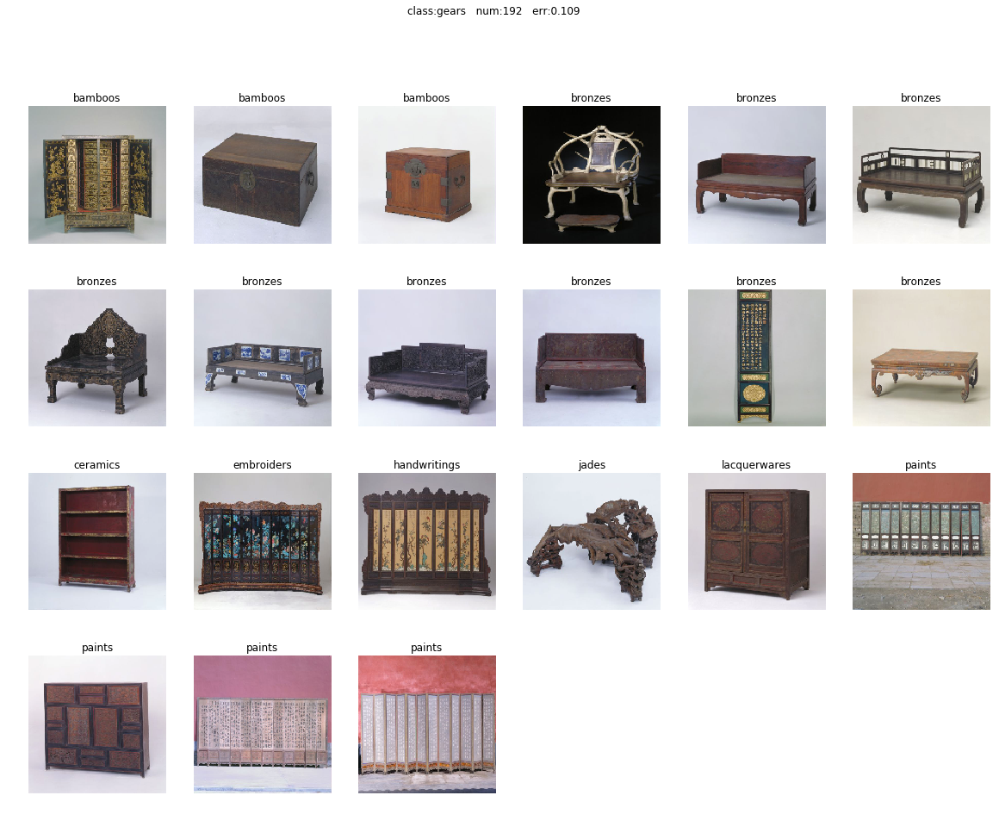

开始计算:handwritings
[5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 8 5 5 5 5 5 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5 5 5 5 5
 5 8 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 8 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5 5 5 8 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5]


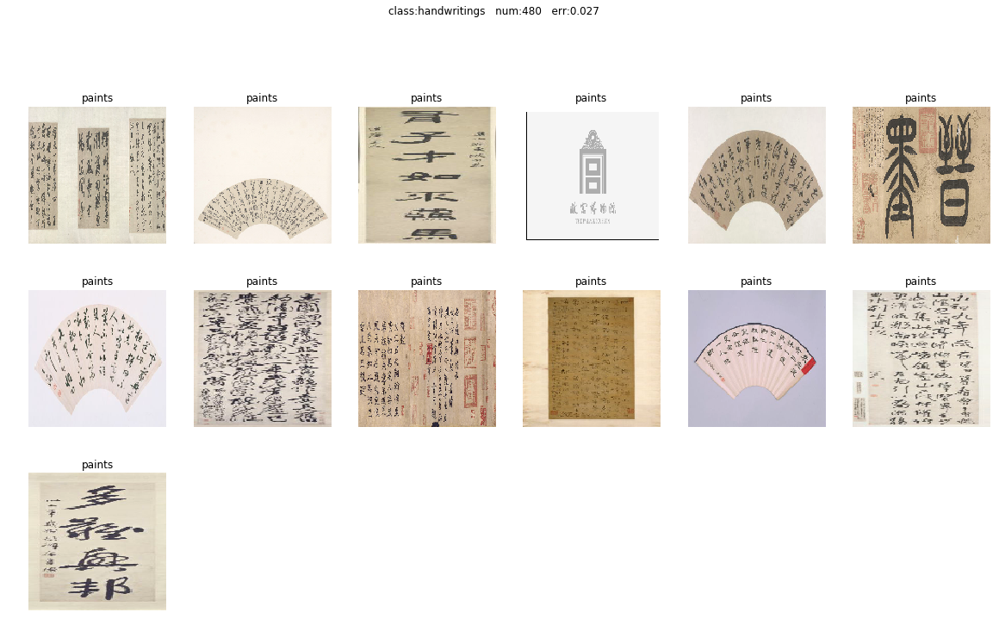

开始计算:jades
[0 6 1 8 2 7 2 1 6 1 1 2 6 3 6 6 2 9 8 2 6 6 6 2 6 6 6 6 6 6 6 1 6 2 2 6 6
 2 1 6 6 6 2 6 0 6 3 9 6 6 6 8 0 6 6 7 6 6 1 6 6 2 6 1 2 6 6 6 3 6 6 6 6 6
 8 1 6 6 9 2 6 6 6 6 6 6 6 3 9 1 6 6 2 3 6 6 2 6 6 6 6 1 6 0 0 6 2 2 6 6 1
 6 6 6 6 6 8 6 6 2 6 2 1 6 6 6 6 8 6 6 6 6 6 1 1 6 6 6 6 2 6 2 9 2 6 6 6 6
 6 9 6 6 6 6 6 8 0 6 6 6 0 3 6 6 6 6 6 3 2 6 6 6 2 6 1 6 6 8 6 6 2 6 6 6 6
 6 6 1 6 2 0 6 6 6 6 6 6 6 2 0 6 6 1 6 6 6 2 6 6 6 6 6 2 2 2 2 6 8 6 6 6 6
 6 2 6 1 6 6 1 6 6 6 6 6 6 6 6 6 1 2 6 2 6 6 6 6 2 6 2 6 0 2 6 2 6 6 6 6 2
 2 6 6 6 2 1 6 6 2 6 6 6 6 3 6 1 1 6 7 2 1 6 6 6 6 6 6 2 2 1 9 6 6 2 2 6 6
 3 8 6 6 6 6 6 6 6 2 1 6 9 9 6 2 6 6 6 1 6 2 6 6 2 1 6 6 6 6 6 6 6 6 6 6 6
 6 2 6 8 6 2 6 6 6 0 6 2 2 3 6 8 5 6 6 6 6 8 6 6 6 1 6 2 2 6 6 6 2 6 6 6 2
 6 2 7 2 6 6 1 6 6 6 6 6 8 6 2 3 8 6 6 6 6 2 6 2 2 2 0 6 6 6 2 6 6 6 6 6 6
 6 6 2 2 0 2 1 1 6 6 6 6 6 6 6 2 1 6 6 2 6 6 6 6 6 6 8 6 2 0 6 1 6 6 6 6 9
 6 6 6 6 6 6 6 6 6 2 2 1 6 6 1 6 6 6 6 6 2 1 6 0 6]


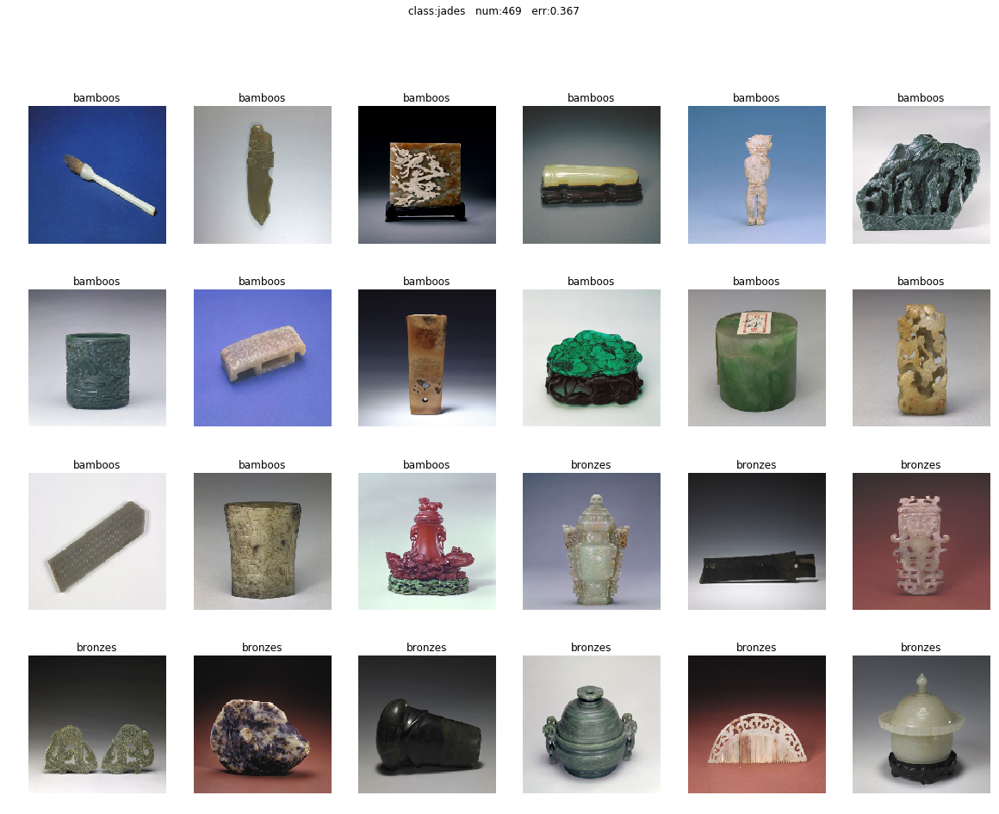

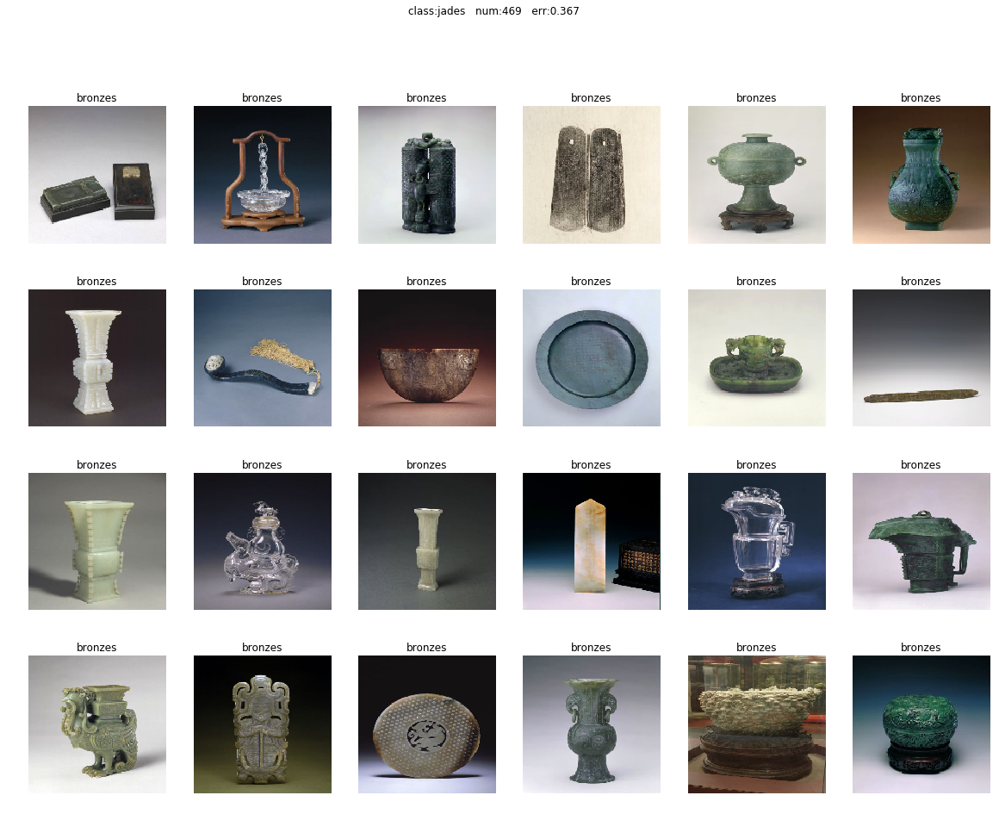

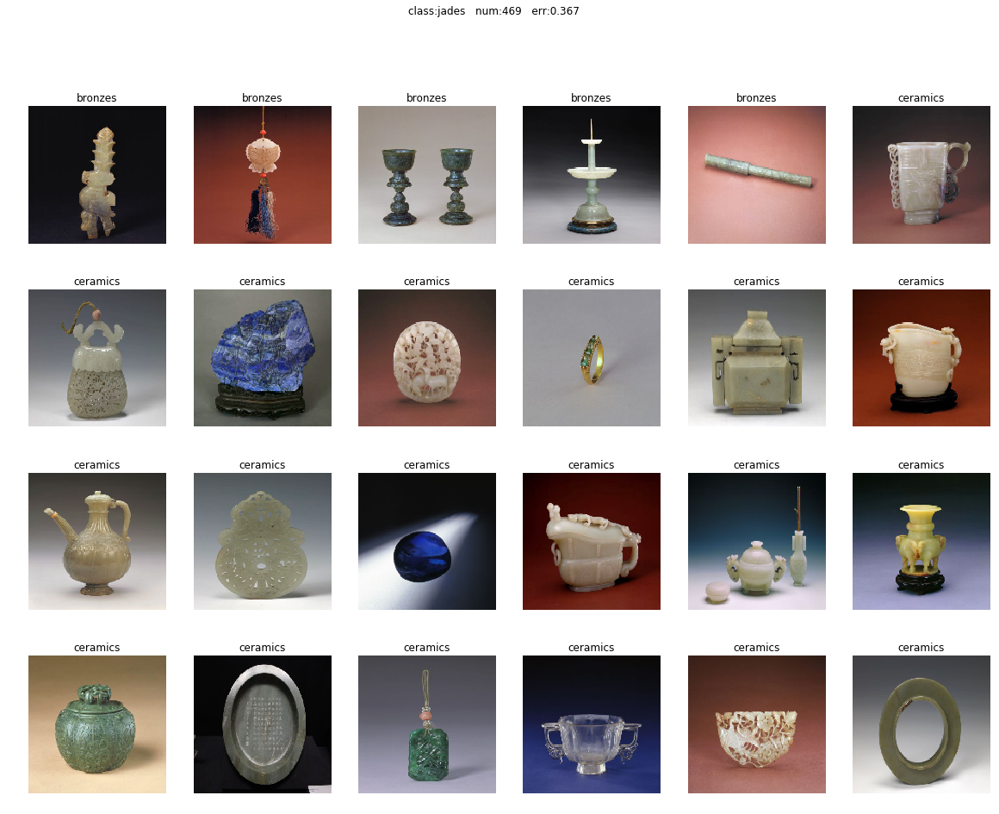

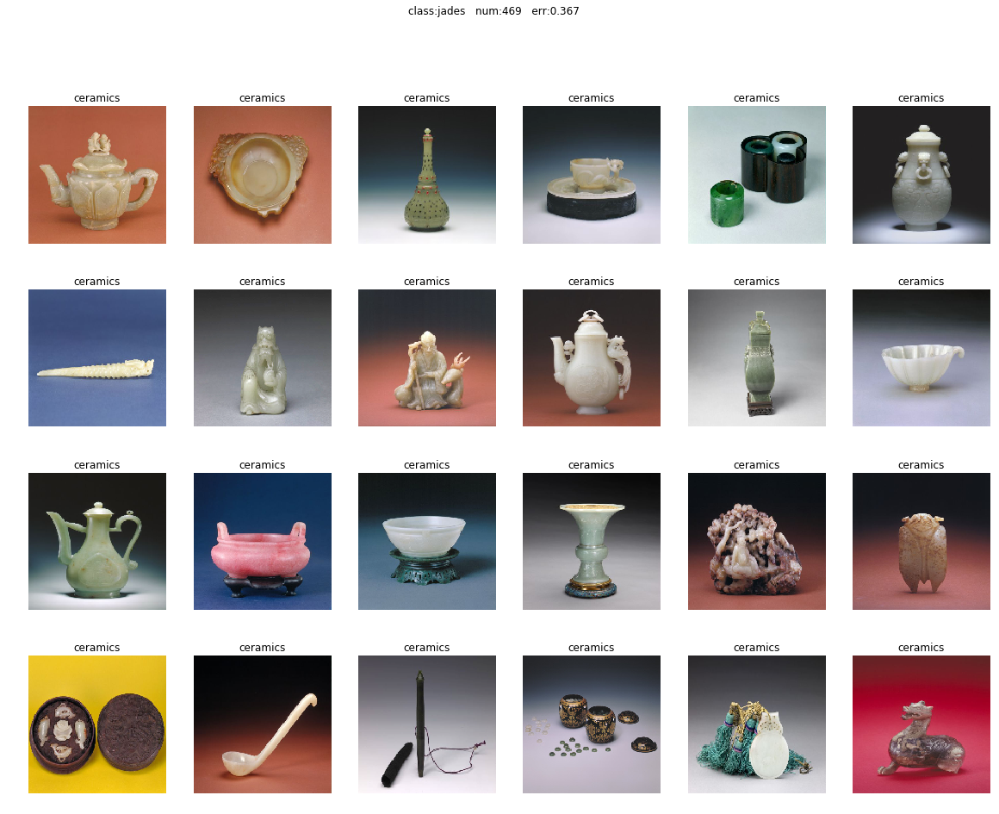

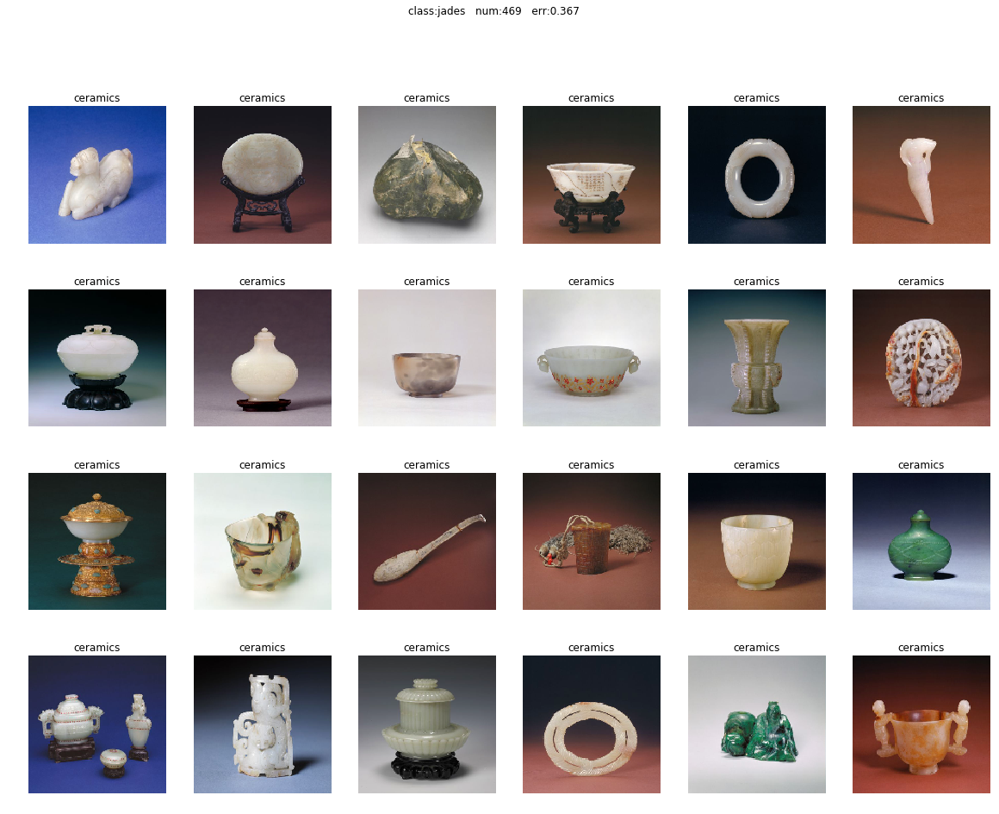

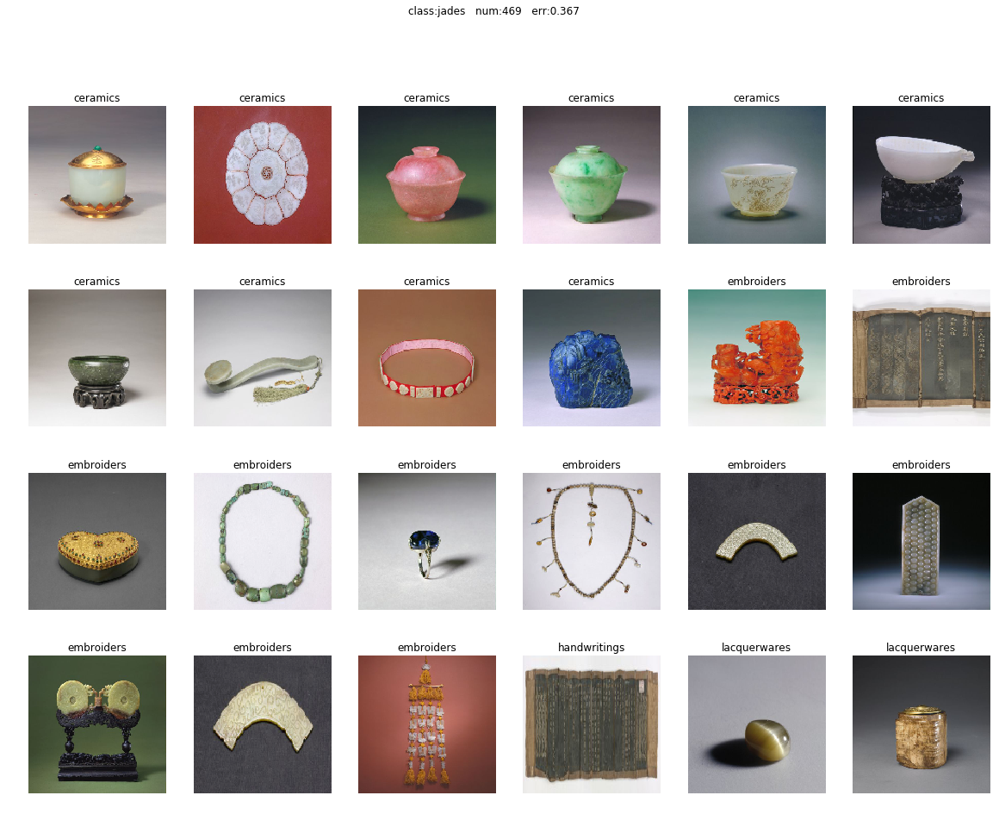

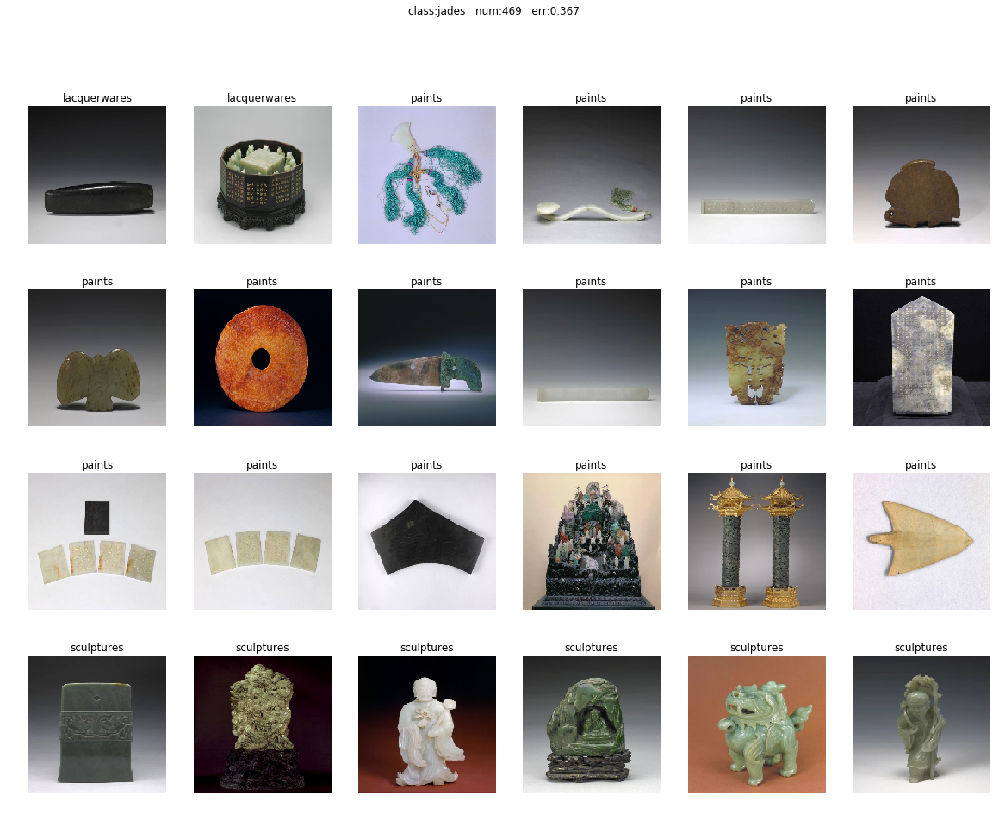

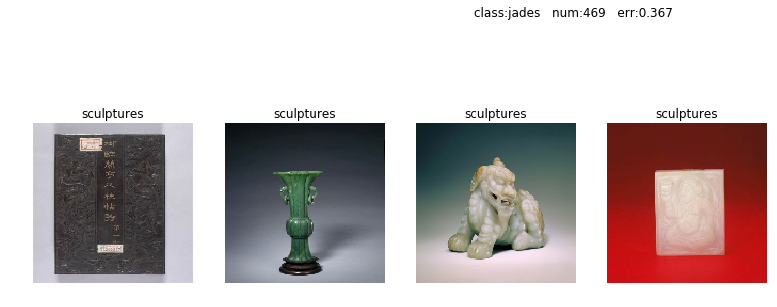

开始计算:lacquerwares
[7 3 7 7 2 7 7 7 7 7 7 1 7 7 7 8 7 7 7 2 7 7 7 7 2 7 7 7 7 7 7 7 7 7 7 7 7
 9 7 7 0 7 7 7 0 7 7 7 7 7 2 0 7 7 7 7 3 7 7 7 7 7 7 2 7 7 7 7 8 7 7 7 7 7
 7 3 7 7 7 7 7 7 7 7 7 7 7 7 4 7 7 7 7 2 7 7 7 7 7 7 7 7 7 7 0 7 7 6 1 7 7
 7 3 2 7 7 7 2 7 7 7 1 7 7 7 7 7 7 0 7 7 3 7 7 0 7 7 7 7 7 7 7 7 3 4 7 7 7
 7 7 7 5 7 7 7 7 7 7 7 7 7]


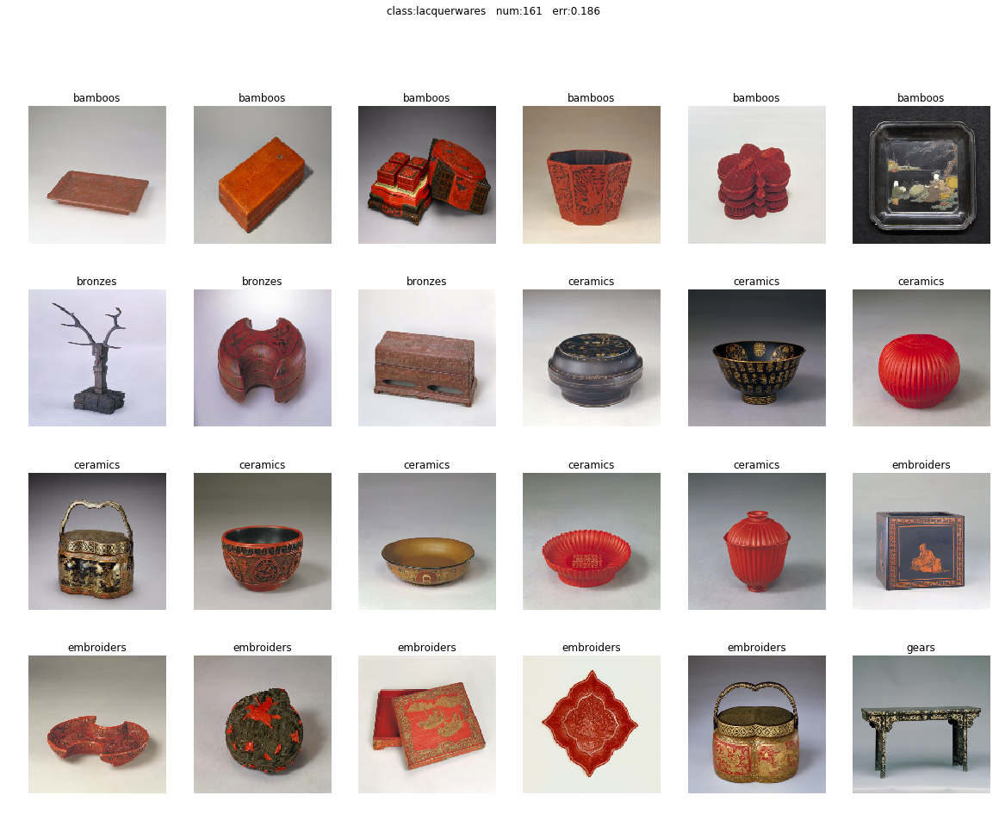

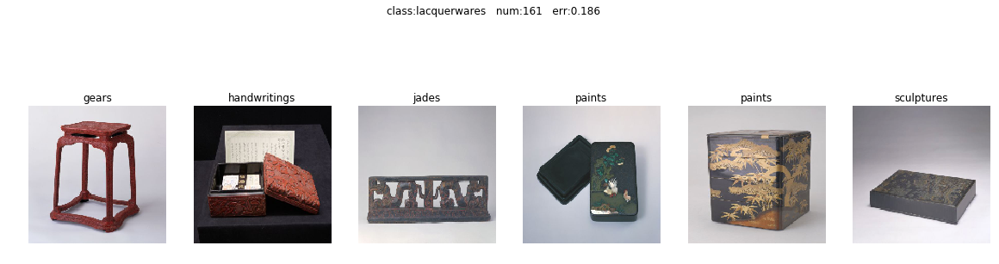

开始计算:paints
[8 8 8 ..., 8 8 8]


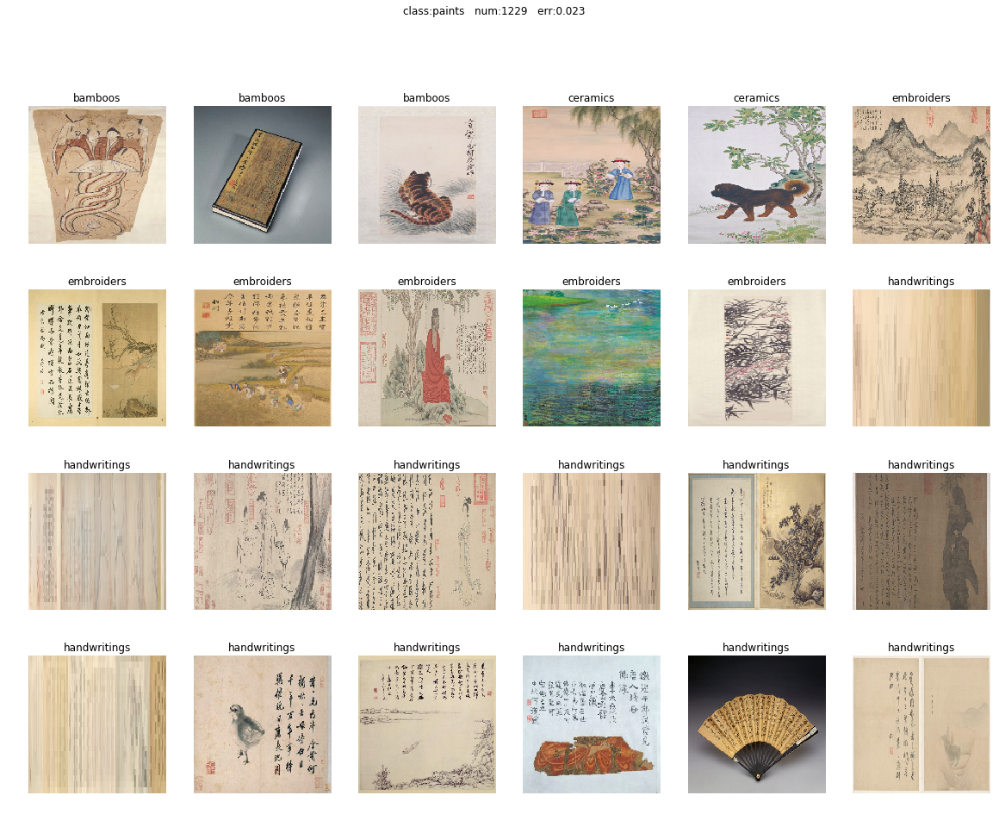

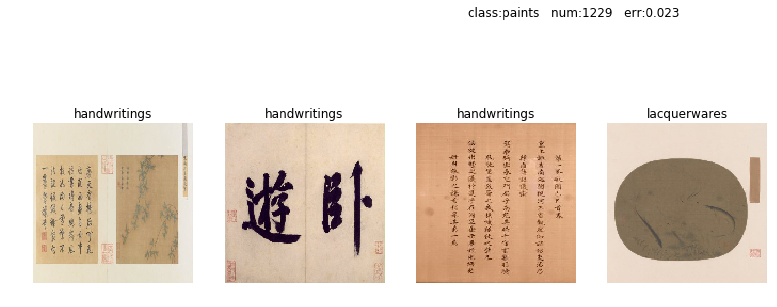

开始计算:sculptures
[9 9 9 9 9 9 9 9 2 9 9 9 9 9 9 9 9 2 9 9 9 9 2 9 9 9 9 1 9 9 9 9 9 9 9 1 9
 9 9 0 9 9 9 9 9 9 9 4 8 9 9 2 9 9 9 9 1 8 9 9 9 3 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 8 9 2 9 9 9 9 9 9 9 9 9 1 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 0 9 9 9 9 9 0 9 9 9 2 9 9 9 9 8 9 9 9 8 1 9 9 2 9 2 9 9 9 9 1 9 9
 9 9 9 9 9 2 8 9 9 9 9 9 9 9 9 8 9 9 9 9 9 9 9 9 9 9 9 9 0 9 9 9 8 9 9 9 2
 9 9 9 9 9 9 9 9 9 9 9 0 9 9 9 9 9 9 9 2 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 3 9 9 9 9 9 9 9 9 9 9 1 9 9 9 9 9 9 9 9 9 9 1 1 9 6 0 9 9 9 9 9 9 2 0 9
 9 9 9 9 9 9 8 9 9 9 9 9 9]


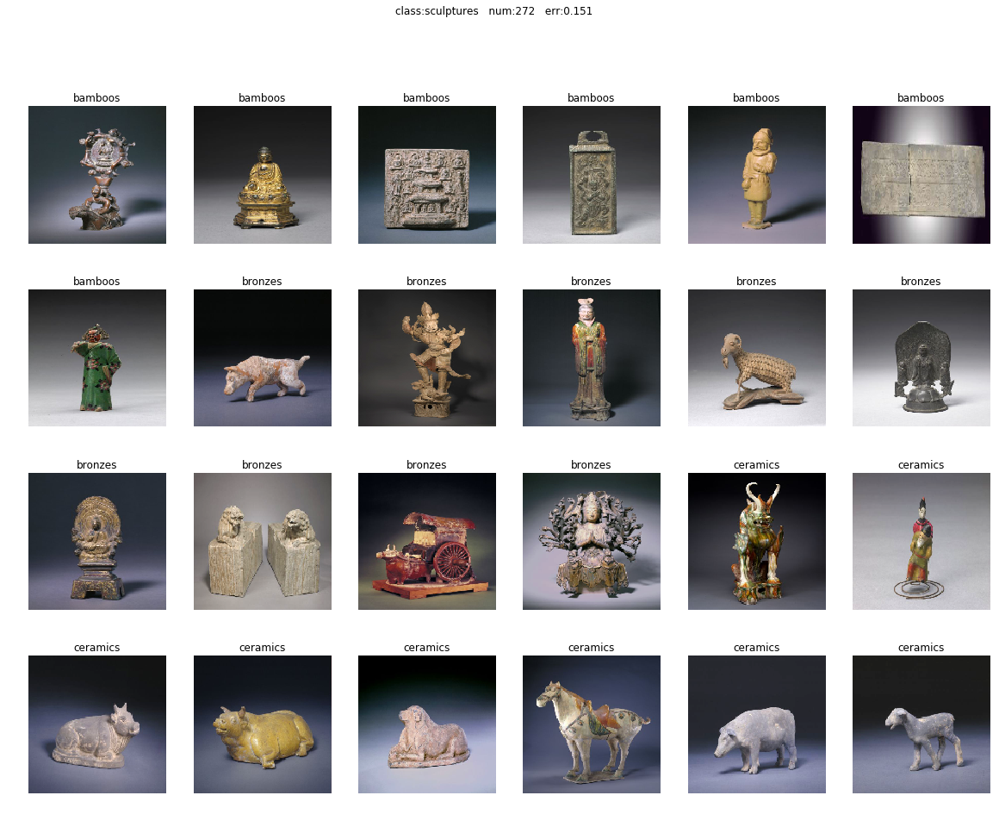

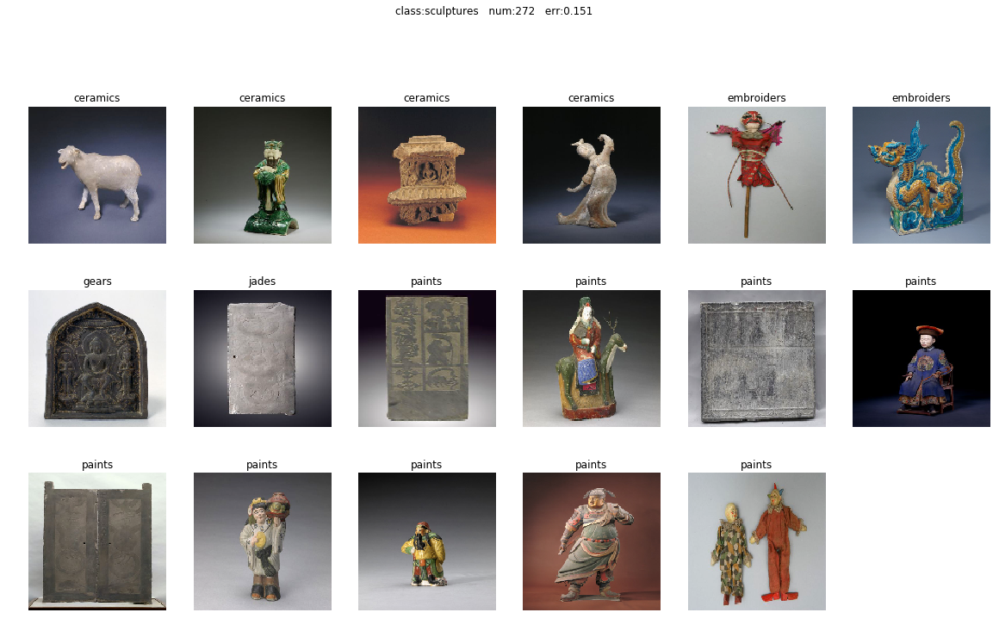

In [173]:
errs = []
for i in range(len(os.listdir(base_dir))):
    err = plot_err_img(base_dir,i,model1,model2,r"imgs\err_img")
    errs.append(err)

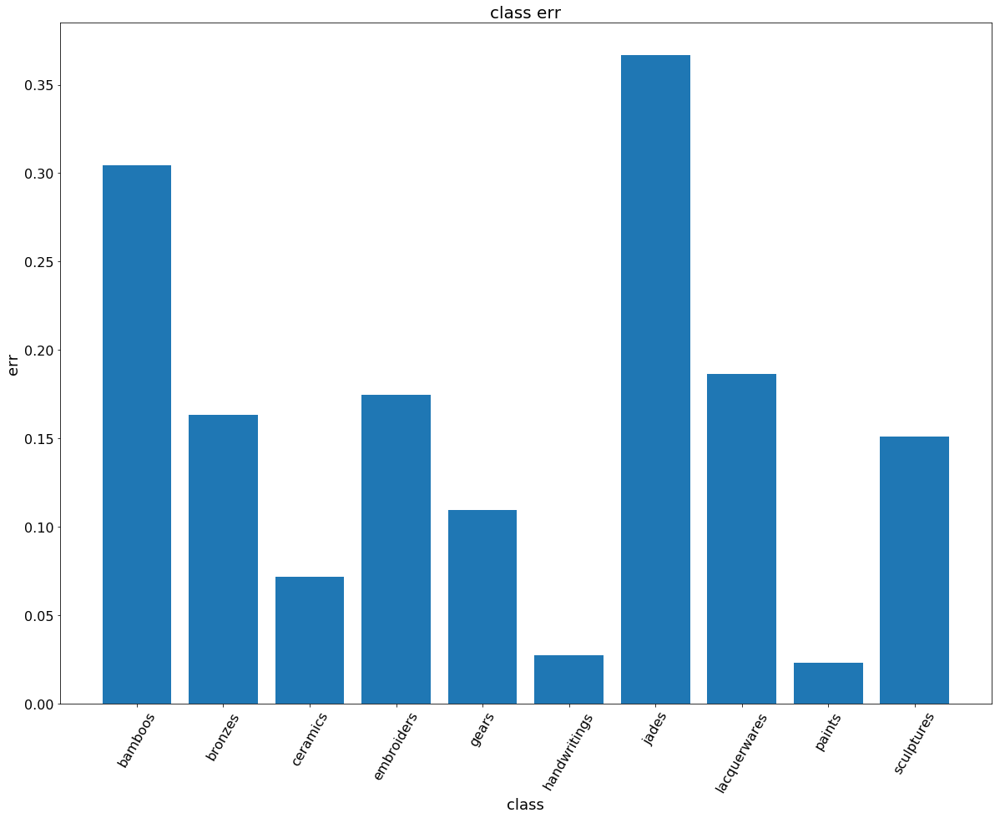

In [216]:
plt.figure(figsize=(20,15))
plt.bar(range(len(errs)),errs)
plt.xticks(range(len(errs)),os.listdir(base_dir),rotation=60)
plt.tick_params(labelsize=16)
plt.xlabel("class",fontsize=18)
plt.ylabel("err",fontsize=18)
plt.title("class err",fontsize=20)
plt.savefig(r"imgs\err_img\errs.png")
# plt.text(0.0,0.4,"vgg16 extract features and predict on dense network",fontdict={'size':'10','color':'b'})
plt.show()

In [199]:
plt.xticks?

In [4]:
import os
import pickle
import numpy as np

In [5]:
pkz_dir = r"F:\jupyter-notebook\deeplearning\features"
f_pkz_base = r"vgg16_dpm_10_224"

In [6]:
f_pkzs = [os.path.join(pkz_dir,x) for x in os.listdir(pkz_dir) if x.startswith(f_pkz_base)]

In [7]:
x,y = None,None
for f_pkz in f_pkzs:
    print("load ",f_pkz)
    with open(f_pkz,'rb') as f: 
        data_batch = pickle.load(f)
    if x == None:
        x = data_batch["x"]
        y = data_batch["y"]
    else:
        x = np.concatenate((x,data_batch["x"]))
        y = np.concatenate((y,data_batch["y"]))
print(x.shape,y.shape)
    

load  F:\jupyter-notebook\deeplearning\features\vgg16_dpm_10_224_batch1
(5147, 7, 7, 512) (5147, 10)


In [17]:
print(y.shape)
Y = np.argmax(y,axis=1)
print(Y.shape)
print(max(Y))
y1 = Y[:4000]
y2 = Y[4000:]

(7506, 23)
(7506,)
22


In [18]:
from collections import Counter

In [19]:
c1 = Counter(Y)
c2 = Counter(y1)
c3 = Counter(y2)


In [20]:
offset = np.random.randint(1,4147)
c4 = Counter(Y[offset: offset + 500])
print(offset)
offset = np.random.randint(1,4147)
c5 = Counter(Y[offset: offset + 500])
print(offset)
offset = np.random.randint(1,4147)
c6 = Counter(Y[offset: offset + 500])
print(offset)

1106
2915
1231


In [21]:
print(c4.items())

dict_items([(0, 24), (1, 14), (2, 91), (3, 18), (4, 4), (5, 34), (6, 6), (7, 1), (8, 10), (9, 2), (10, 39), (11, 26), (12, 44), (13, 5), (14, 12), (15, 6), (16, 75), (17, 15), (18, 20), (19, 16), (20, 7), (21, 11), (22, 20)])


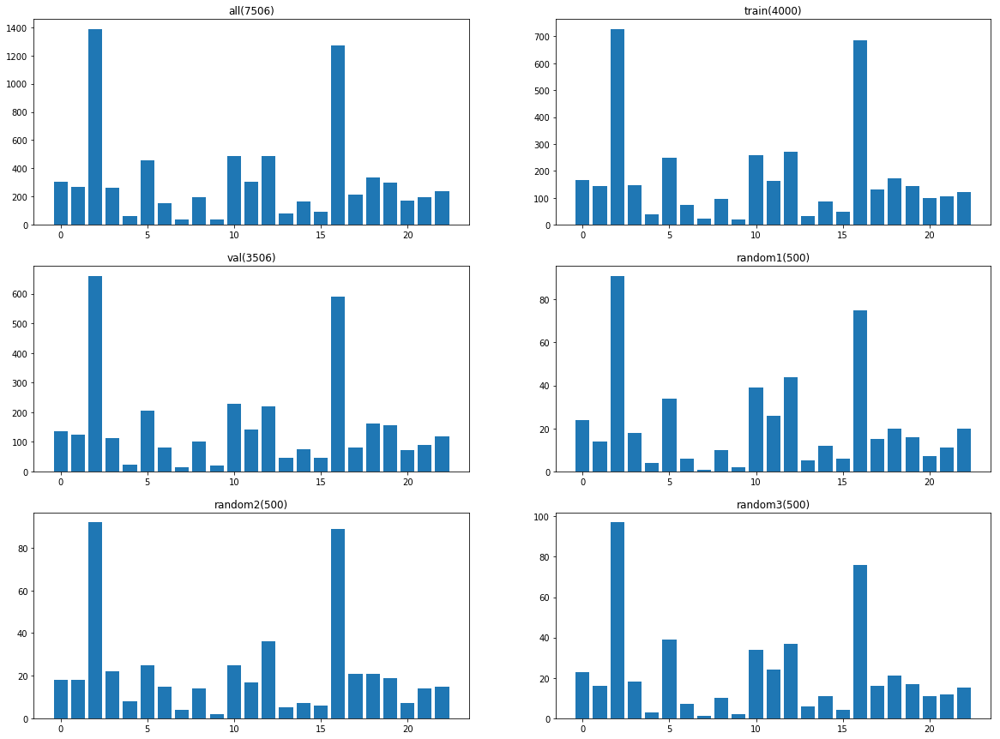

In [24]:
from matplotlib import pyplot as plt
plt.figure(figsize=(20,15))
i = 0
for s in [("all(7506)",c1),("train(4000)",c2),("val(3506)",c3),("random1(500)",c4),("random2(500)",c5),("random3(500)",c6)]:
    i += 1
    plt.subplot(3,2,i)
    plt.bar(range(23),[x[1] for x in list(s[1].items())])
    plt.title(s[0])
    
# plt.figure()
# plt.bar(range(10),[x[1] for x in list(c1.items())])
# plt.title("train")
# plt.figure()
# plt.bar(range(10),[x[1] for x in list(c2.items())])
# plt.title("val")
plt.show()

In [84]:
model = get_dense_model(10,input_dim=1*1*2048)

In [85]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_11 (Dense)             (None, 256)               524544    
_________________________________________________________________
dropout_6 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_12 (Dense)             (None, 10)                2570      
Total params: 527,114
Trainable params: 527,114
Non-trainable params: 0
_________________________________________________________________


In [86]:
x.shape

(5147, 1, 1, 2048)

In [87]:
X = np.reshape(x,(x.shape[0],-1))

In [88]:
X.shape

(5147, 2048)

In [89]:
y.shape

(5147, 10)

In [90]:
model.compile(optimizer=optimizers.RMSprop(lr=1e-4),loss=losses.categorical_crossentropy,metrics=['acc'])

In [91]:
slices = np.arange(len(X))

In [92]:
np.random.shuffle(slices)

In [93]:
X = X[slices]
Y = y[slices]

In [94]:
import copy
z =copy.copy(y)
acc = []
for i in range(100):
    np.random.shuffle(z)
    res = [1 if np.argmax(z[i]) == np.argmax(y[i]) else 0 for i in range(len(z))]
    acc.append(sum(res)/len(res))
print("基线测试", sum(acc)/len(acc))

基线测试 0.16022925976296873


In [95]:
hist = model.fit(X,Y,epochs=50,batch_size=32,verbose=1,validation_split=0.3,shuffle=True)

Train on 3602 samples, validate on 1545 samples
Epoch 1/50
3602/3602 [==============================] - 2s 672us/step - loss: 2.2614 - acc: 0.2224 - val_loss: 2.0359 - val_acc: 0.2628
Epoch 2/50
3602/3602 [==============================] - 2s 487us/step - loss: 2.1074 - acc: 0.2510 - val_loss: 2.0232 - val_acc: 0.2382
Epoch 3/50
3602/3602 [==============================] - 2s 452us/step - loss: 2.0570 - acc: 0.2643 - val_loss: 2.0063 - val_acc: 0.2893
Epoch 4/50
3602/3602 [==============================] - 2s 483us/step - loss: 2.0243 - acc: 0.2796 - val_loss: 1.9791 - val_acc: 0.2744
Epoch 5/50
3602/3602 [==============================] - 2s 547us/step - loss: 2.0076 - acc: 0.2829 - val_loss: 1.9595 - val_acc: 0.2861
Epoch 6/50
3602/3602 [==============================] - 2s 495us/step - loss: 1.9876 - acc: 0.3112 - val_loss: 1.9433 - val_acc: 0.4201
Epoch 7/50
3602/3602 [==============================] - 2s 652us/step - loss: 1.9697 - acc: 0.3132 - val_loss: 1.9324 - val_acc: 0.4654


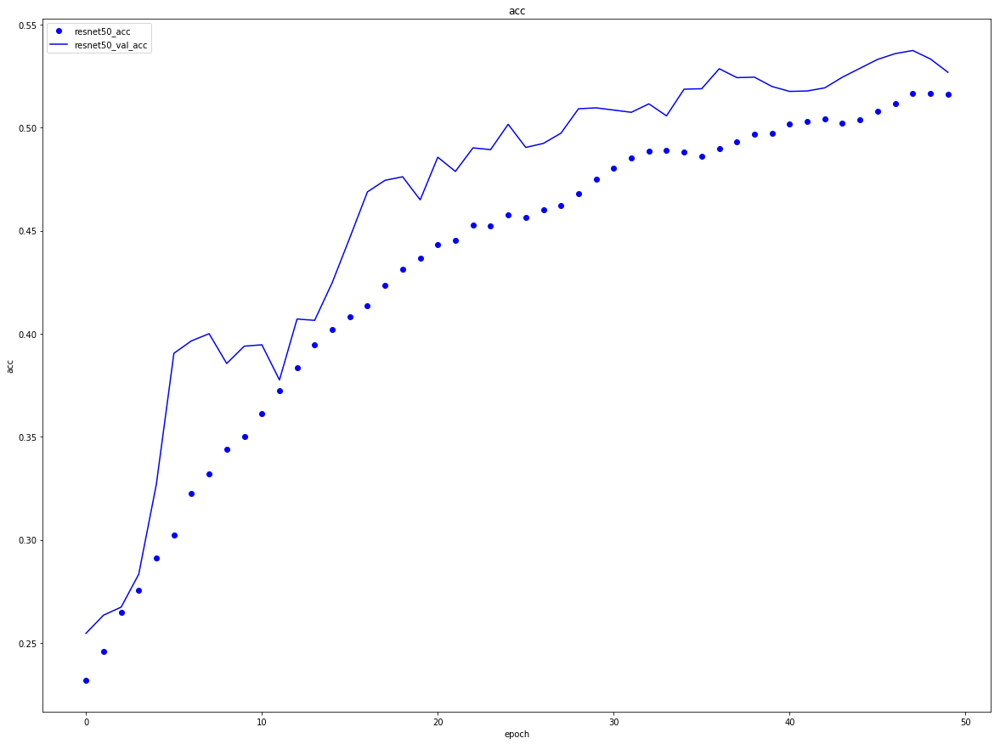

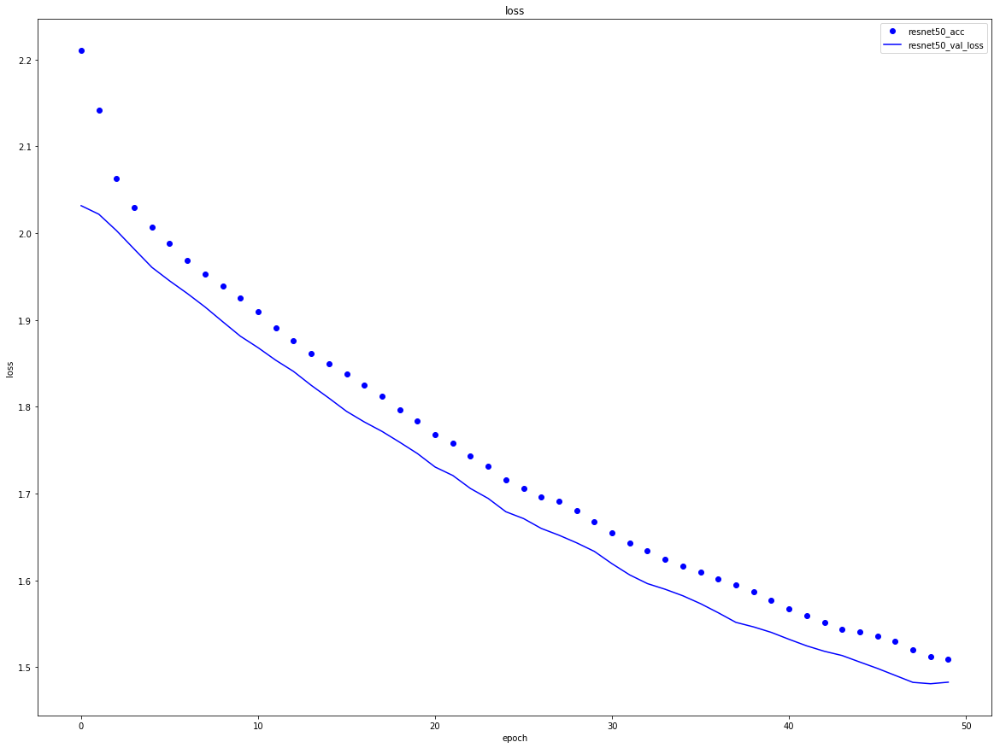

In [96]:
plot_res({"resnet50":hist})

In [5]:
from pymongo import MongoClient

client = MongoClient()

db = client.get_database("keras")

res_col = db.get_collection("dpm")

In [97]:
res_col.insert_one({
        "features":"resnet50_dpm_10_224",
        "hist":hist.history
    })

In [6]:
data = list(res_col.find())

In [10]:
model3_data = [x for x in data if x.get("model","none")=="get_dense_model3"]
model2_data = [x for x in data if x.get("model","none")=="get_dense_model2"]
model1_data = data[4:9]

In [11]:
vgg16_data = [x for x in data[4:] if x["features"].startswith("vgg16")]

In [16]:
model3_hists = {}
for x in model3_data:
    model3_hists[x.get("features","none")] = {"history":x["hist"]}

In [19]:
model2_hists = {}
for x in model2_data:
    model2_hists[x.get("features","none")] = {"history":x["hist"]}

In [21]:
model1_hists = {}
for x in model1_data:
    model1_hists[x.get("features","none")] = {"history":x["hist"]}

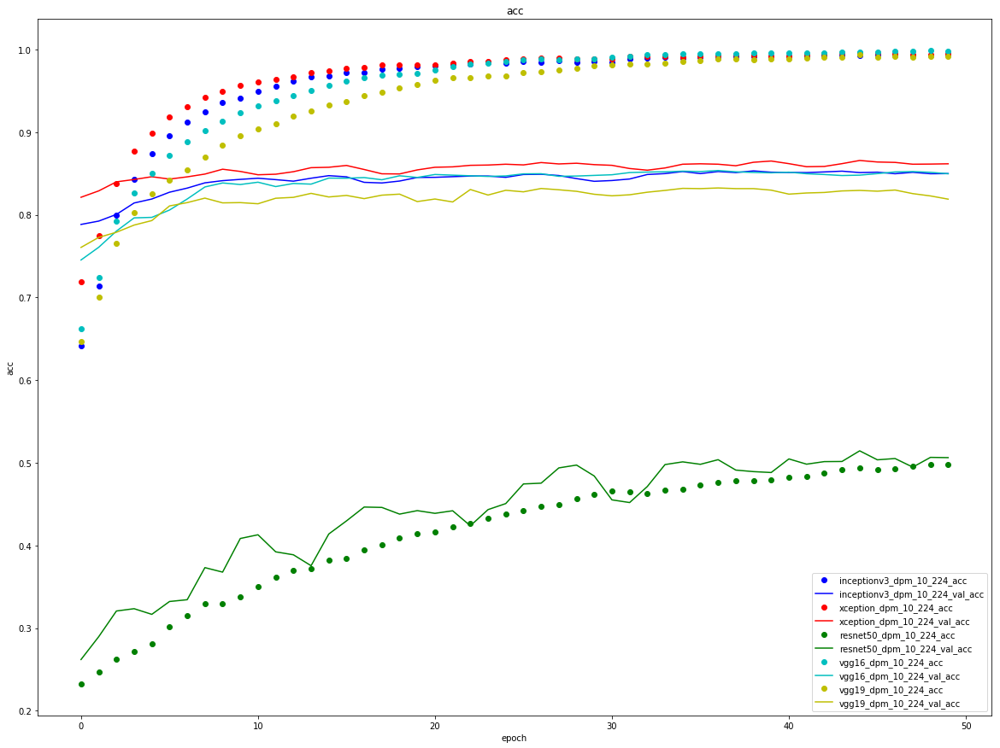

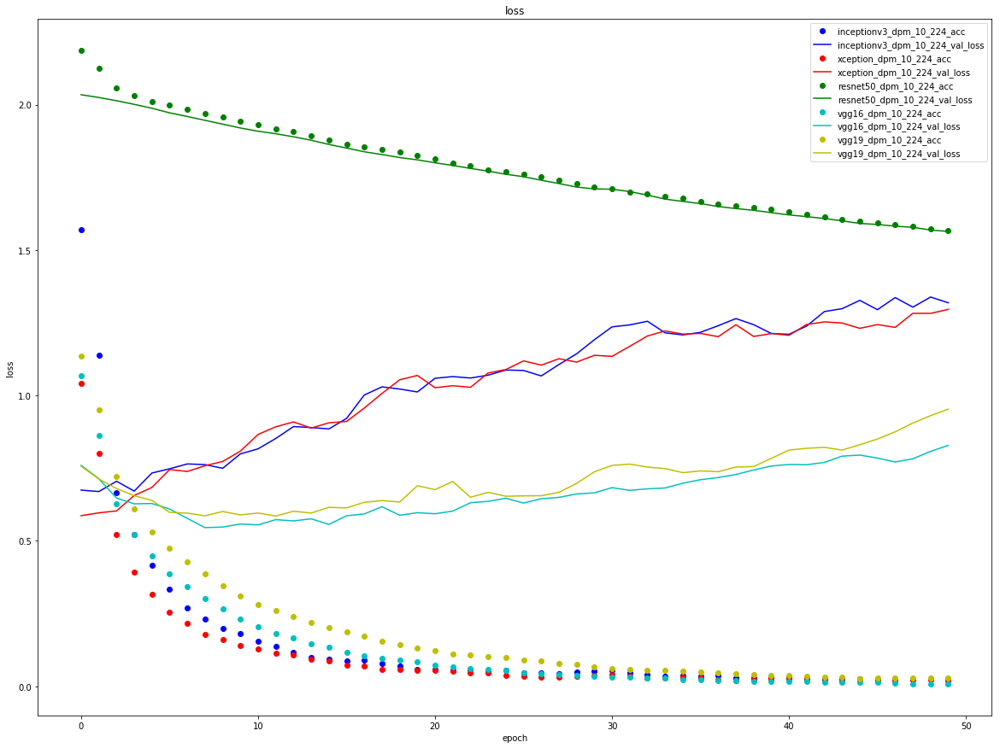

In [22]:
plot_res(model1_hists)

In [26]:
for x in model1_data:
    x["model"] = "get_dense_model1"

In [28]:
all = []
all.extend(model1_data)
all.extend(model2_data)
all.extend(model3_data)

In [29]:
len(all)

15

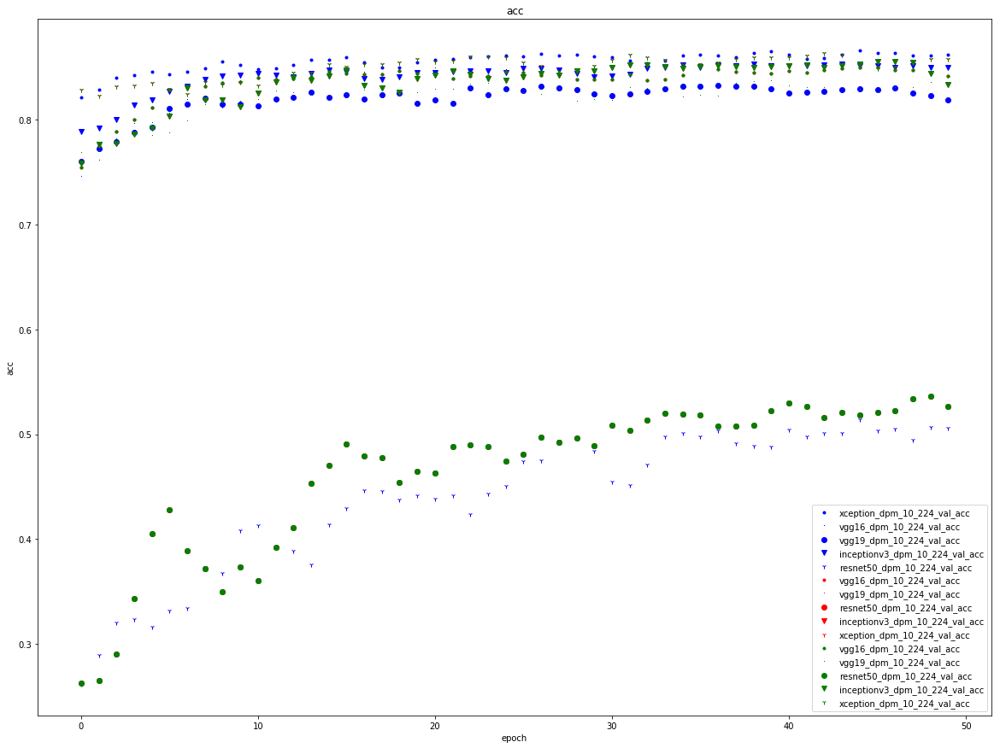

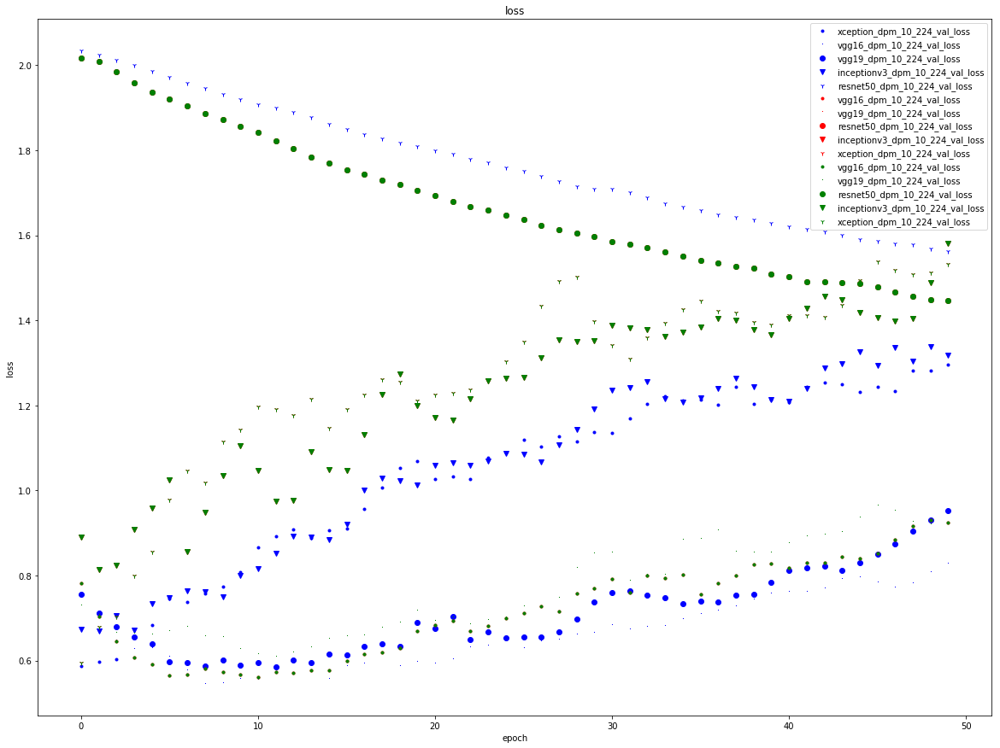

In [36]:
plot_res_cpmpare_model(all,["get_dense_model1","get_dense_model2","get_dense_model2"])

[{'_id': ObjectId('5bbd70045562772130193733'),
  'features': 'vgg16_dpm_10_224',
  'hist': {'acc': [0.617333333333333,
    0.752666666984558,
    0.801666666984558,
    0.823666666666667,
    0.854666666666667,
    0.872,
    0.890333333333333,
    0.901666666984558,
    0.914000000317891,
    0.923333333651225,
    0.934000000158946,
    0.938666666984558,
    0.942333333651225,
    0.95,
    0.960333333651225,
    0.958333333492279,
    0.968000000317891,
    0.971333333651225,
    0.968,
    0.970333333651225,
    0.976,
    0.980666666666667,
    0.980666666666667,
    0.984333333333333,
    0.985,
    0.987,
    0.989666666666667,
    0.988000000317891,
    0.986333333651225,
    0.992,
    0.988,
    0.992666666666667,
    0.993,
    0.995,
    0.993000000317891,
    0.996333333333333,
    0.994333333333333,
    0.994333333333333,
    0.996333333333333,
    0.996333333333333,
    0.995,
    0.995666666666667,
    0.996333333333333,
    0.997,
    0.996,
    0.996666666666667,
   

In [40]:
xception_model_data = [h for h in data[4:] if h["features"].startswith("xception")]

In [41]:
len(xception_model_data)

3

In [42]:
[x.get("model") for x in xception_model_data]

['get_dense_model1', 'get_dense_model2', 'get_dense_model3']

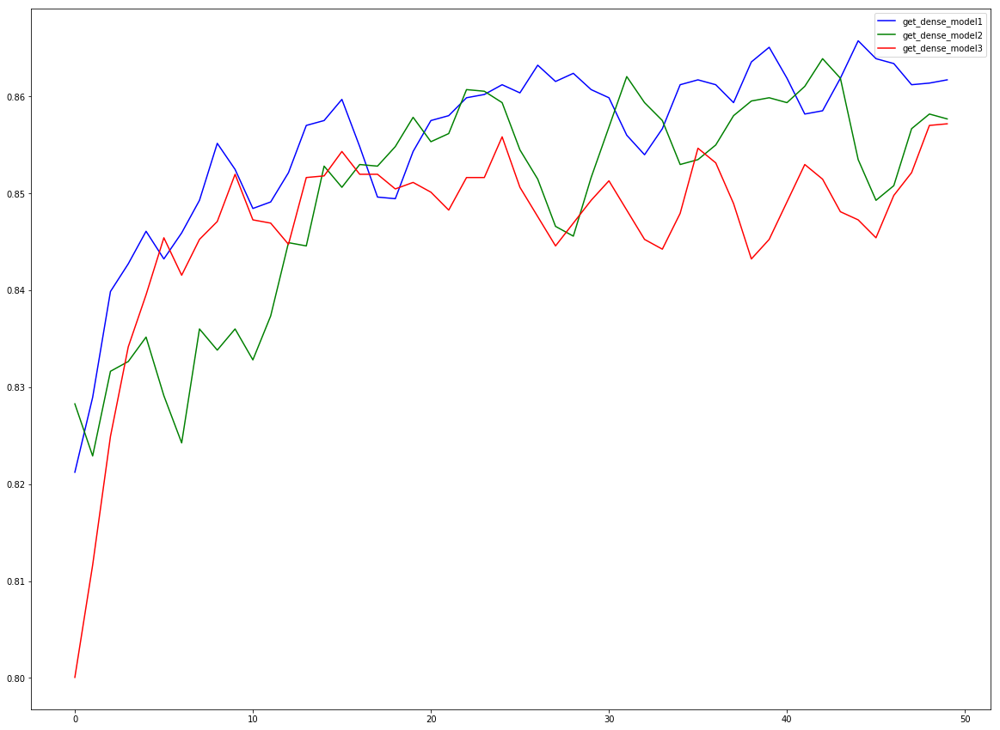

In [48]:
colors = ['b','g','r']
plt.figure(figsize=(20,15))
for i,h in enumerate(xception_model_data):
    name = h['model']
    hist = h['hist']
    plt.plot(range(len(hist['val_acc'])),smooth_curve(hist['val_acc']),"%s"%colors[i],label=name)
    plt.legend()
plt.show()
    

7


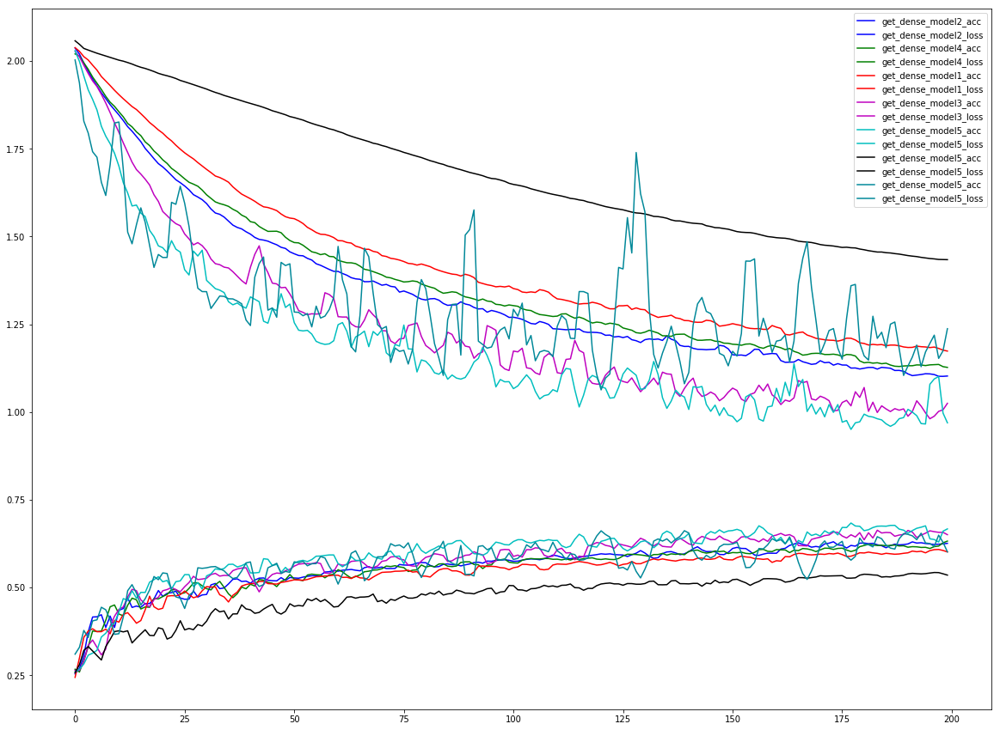

In [60]:
resnet_data = [h for h in list(res_col.find()) if h.get("comment","none").startswith("resnet")]

print(len(resnet_data))

colors = ['b','g','r','m','c','k','#008899']
plt.figure(figsize=(20,15))
for i,h in enumerate(resnet_data):
    name = h["model"]
    hist = h["hist"]
    plt.plot(range(200),smooth_curve(hist["val_acc"]),colors[i],label=name+'_acc')
    plt.plot(range(200),smooth_curve(hist["val_loss"]),colors[i],label=name+'_loss')
    plt.legend()
plt.show()

In [55]:
plt.plot?

In [61]:
from sklearn import svm

In [71]:
x.shape

(5147, 25088)

In [72]:
y.shape

(5147, 10)

In [73]:
y = np.argmax(y,axis=1)

In [74]:
y.shape

(5147,)

In [75]:
clf = svm.SVC(gamma="scale")


In [76]:
clf.fit(x[:3000],y[:3000])

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [77]:
pre = clf.predict(x[3000:])

In [78]:
pre[:10]

array([8, 8, 8, 2, 8, 5, 2, 2, 8, 8], dtype=int64)

In [79]:
prey = y[3000:]

In [80]:
prey[:10]

array([8, 3, 8, 0, 3, 5, 1, 3, 8, 8], dtype=int64)

In [81]:
score = sum([1 if pre[i]==prey[i] else 0 for i in range(len(pre))])

In [82]:
score

1565

In [83]:
score = score/len(pre)

In [84]:
score

0.7289240801117839

In [85]:
clf2 = svm.SVC(gamma='scale', decision_function_shape='ovo')

In [86]:
clf2.fit(x[:3000],y[:3000])

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovo', degree=3, gamma='scale', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [87]:
pre2 = clf2.predict(x[3000:])

In [88]:
score2 = sum([1 if pre2[i]==prey[i] else 0 for i in range(len(pre))])

In [89]:
score2

1565

In [90]:
clf3 = svm.LinearSVC()

In [91]:
clf3.fit(x[:3000],y[:3000])

E:\anaconda\envs\tensorflow-gpu\lib\site-packages\sklearn\svm\base.py:922: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=1000,
     multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
     verbose=0)

In [92]:
pre3 = clf3.predict(x[3000:])

In [93]:
score3 = sum([1 if pre3[i]==prey[i] else 0 for i in range(len(pre))])

In [94]:
score3

1804

In [95]:
score3/len(pre)

0.8402421984163949

In [96]:
clf4 = svm.SVC(gamma="scale",kernel="linear")

In [97]:
clf4.fit(x[:3000],y[:3000])

SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='scale', kernel='linear',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

In [98]:
pre4 = clf4.predict(x[3000:])

In [99]:
score4 = sum([1 if pre4[i]==prey[i] else 0 for i in range(len(pre))])

In [101]:
score4/len(pre)

0.8425710293432697

In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [102]:
from PIL import Image

In [103]:
dir = r"G:\pic_data\dpm\origin\type10\bamboos"

In [104]:
import os

In [105]:
imgs = os.listdir(dir)

In [106]:
imgs[0]

'“普天同庆班”笏板及架.jpg'

In [107]:
imgs = [os.path.join(dir,img) for img in imgs]

In [108]:
imgs[0]

'G:\\pic_data\\dpm\\origin\\type10\\bamboos\\“普天同庆班”笏板及架.jpg'

In [124]:
img = Image.open(imgs[0])

In [125]:
img = img.resize((150,150))
a = np.asarray(img)

In [131]:
import os
from PIL import Image
im
base_dir = r"G:\\pic_data\\dpm\\origin\\type10\\"
x = np.zeros((5147,150,150,3))
y = np.zeros((5147,))
i = 0
for j,cls in enumerate(os.listdir(base_dir)):
    subdir = os.path.join(base_dir,cls)
    for f_img in os.listdir(subdir):
        f_img = os.path.join(subdir,f_img)
        print(i,f_img)
        img = Image.open(f_img)
        img = img.resize((150,150))
        if img.mode != "RGB":
            img = img.convert("RGB")
        img_arr = np.asarray(img)
        x[i] = img_arr
        y[i] = j
        i += 1
        
        

1 G:\\pic_data\\dpm\\origin\\type10\\bamboos\“普天同庆班”笏板及架.jpg
2 G:\\pic_data\\dpm\\origin\\type10\\bamboos\乌木嵌螺钿双螭纹小盒.jpg
3 G:\\pic_data\\dpm\\origin\\type10\\bamboos\乔林款竹根雕兰亭修禊图笔筒.jpg
4 G:\\pic_data\\dpm\\origin\\type10\\bamboos\乾隆紫檀嵌石花卉笔筒.jpg
5 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制“万邦协和”鼻烟壶.jpg
6 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制三凤纹圆盒.jpg
7 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制乾隆御题六棱瓶.jpg
8 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制乾隆御题花卉纹扁圆盒.jpg
9 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制乾隆御题蕃莲纹碗.jpg
10 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制八方笔筒.jpg
11 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制凸花纹盒.jpg
12 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制勾云团寿字纹盘.jpg
13 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制勾云纹漆里花口盘.jpg
14 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制勾莲纹圆盒.jpg
15 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制勾莲纹壶.jpg
16 G:\\pic_data\\dpm\\origin\\type10\\bamboos\匏制勾莲纹带托高足碗.jpg
17 G:\\pic_data\\dpm\\origin\\type10\\bamboos\

ValueError: could not broadcast input array from shape (150,150,4) into shape (150,150,3)

In [135]:
img = "G:\\pic_data\\dpm\\origin\\type10\\ceramics\松石绿釉镂空花篮.jpg"

In [136]:
img = Image.open(img)

In [139]:
Image.convert?

Object `Image.convert` not found.


In [14]:
import os
import pickle
import numpy as np

pkz_dir = r"F:\jupyter-notebook\deeplearning\features"
f_pkzs = [os.path.join(pkz_dir, x) for x in os.listdir(pkz_dir) if x.startswith("vgg16_dpm_23_224")]
print(f_pkzs)

x, y = [], []
    

['F:\\jupyter-notebook\\deeplearning\\features\\vgg16_dpm_23_224_batch1', 'F:\\jupyter-notebook\\deeplearning\\features\\vgg16_dpm_23_224_batch2', 'F:\\jupyter-notebook\\deeplearning\\features\\vgg16_dpm_23_224_batch3', 'F:\\jupyter-notebook\\deeplearning\\features\\vgg16_dpm_23_224_batch4']


In [15]:
x, y = [], []

for f_pkz in f_pkzs:
    with open(f_pkz, 'rb') as f:
        print("load ", f_pkz)
        batch_data = pickle.load(f)
        if len(y) == 0:
#             x = batch_data['x']
            y = batch_data['y']
        else:
#             x = np.concatenate((x, batch_data['x']))
            y = np.concatenate((y, batch_data['y']))

load  F:\jupyter-notebook\deeplearning\features\vgg16_dpm_23_224_batch1
load  F:\jupyter-notebook\deeplearning\features\vgg16_dpm_23_224_batch2
load  F:\jupyter-notebook\deeplearning\features\vgg16_dpm_23_224_batch3
load  F:\jupyter-notebook\deeplearning\features\vgg16_dpm_23_224_batch4


In [16]:
y.shape

(7506, 23)